# Network Attack Detection using Machine Learning

Submitted by - <br>
<b>Sada Kakarla (50605634)*, Shivansh Gupta* (50604127), Rahul Ekambaram* (50606691)</b><br><br>
Masters in Engineering Sciences (Artificial Intelligence)<br>
State University of New York at Buffalo, United States<br>

### Dataset:
<i>RoEduNet-SIMARGL2021 Network Intrusion Detection Dataset</i> (NetFlow V9 format)

The dataset is composed by two files:<br>
<ul>
<li>train_set: ~4 million flows, used for training the model<br>
<li>test_set: ~2 million flows, used for testing the model
</ul>

### 1) Loading the Dataset:

##### 1.1 Importing Required Python Libraries

In [775]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
import plotly.express as px
%matplotlib inline
from sklearn.preprocessing import LabelEncoder
import plotly.graph_objs as go
from plotly.subplots import make_subplots

<b>Development of a Mode Flag</b><br><br>

Developing a Mode Flag to ensure seamless model building. If the following flag is set to True, the model will be trained on a smaller dataset, and if set to False, the model will be trained on the whole dataset.


In [660]:
# True implies that only 3% of the data will be used for training & testing the models

_DEVMODE = True

##### 1.2 Loading the Dataset

In [661]:
train_df = pd.read_csv('/Users/shivansh052k/Documents/UB/Semester_1/DIC/Project_1/train_net.csv')
test_df = pd.read_csv('/Users/shivansh052k/Documents/UB/Semester_1/DIC/Project_1/test_net.csv')

In [662]:
print("Test set size: ", test_df.shape)
print("Train set size: ", train_df.shape)

Test set size:  (2077339, 32)
Train set size:  (4217625, 33)


### 2) Data Preprocessing

#### 2.1) Displaying the Metadata of the training datset

In [663]:
train_df.head()

,FLOW_ID,PROTOCOL_MAP,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,IPV4_DST_ADDR,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,...,TOTAL_PKTS_EXP,TOTAL_BYTES_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ALERT,ID
0,372018590,udp,53950,10.114.232.40,53,10.114.226.5,1647760833,1,1647760833,17,...,0,0,165,2,275,2,1647760873,0.0,NaN,0
1,368604472,tcp,37914,10.114.241.166,38303,10.114.224.218,1647686725,1,1647686725,6,...,0,0,44,1,40,1,1647687338,0.0,Port Scanning,1
2,367513992,tcp,33216,10.114.241.166,18757,10.114.224.116,1647680044,0,1647680044,6,...,0,0,44,1,40,1,1647680115,1.0,Port Scanning,2
3,371997670,udp,48627,10.114.225.205,53,10.114.226.5,1647760172,0,1647760172,17,...,0,0,128,2,160,2,1647760207,0.0,NaN,3
4,374311119,udp,35939,10.114.225.205,53,10.114.226.5,1647780916,0,1647780916,17,...,0,0,172,2,300,2,1647780984,0.0,NaN,4


In [664]:
test_df.head()

,FLOW_ID,PROTOCOL_MAP,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,IPV4_DST_ADDR,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,...,MAX_IP_PKT_LEN,TOTAL_PKTS_EXP,TOTAL_BYTES_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ID
0,370548101,udp,50927,10.114.226.5,53,204.61.216.100,1647716065,1,1647716065,17,...,0,0,0,112,1,668,1,1647716129,0.0,0
1,367147345,icmp,0,34.208.29.22,0,10.114.224.244,1647676228,10540,1647676239,1,...,0,0,0,168,2,0,0,1647676273,0.0,1
2,369996289,icmp,0,34.219.129.172,0,10.114.224.218,1647702042,0,1647702042,1,...,0,0,0,84,1,0,0,1647702128,0.0,2
3,374311525,tcp,49738,10.114.225.201,443,185.33.221.15,1647780914,10472,1647780925,6,...,0,0,0,7781,15,4891,14,1647780984,0.0,3
4,338793823,udp,50454,10.114.225.205,53,10.114.226.5,1647416371,0,1647416371,17,...,0,0,0,154,2,322,2,1647416426,NaN,4


In [665]:
train_df.select_dtypes(include=['int64', 'float64']).describe()

,FLOW_ID,L4_SRC_PORT,L4_DST_PORT,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,TCP_FLAGS,TCP_WIN_MAX_IN,TCP_WIN_MAX_OUT,...,MAX_IP_PKT_LEN,TOTAL_PKTS_EXP,TOTAL_BYTES_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ID
count,4.217625e+06,4.217625e+06,4.217625e+06,4.217625e+06,4.217625e+06,4.217625e+06,4.217625e+06,4.217625e+06,4.217625e+06,4.217625e+06,...,4217625.0,4217625.0,4217625.0,4.217625e+06,4.217625e+06,4.217625e+06,4.217625e+06,4.217625e+06,2.313723e+06,4.217625e+06
mean,3.548546e+08,4.202829e+04,8.482456e+03,1.647568e+09,5.891606e+03,1.647568e+09,1.030320e+01,1.046772e+01,1.071608e+04,7.940944e+03,...,0.0,0.0,0.0,1.794091e+04,3.553015e+01,5.972693e+04,5.034809e+01,1.647569e+09,1.806690e-01,2.108812e+06
std,1.786586e+07,1.925435e+04,1.711211e+04,1.729655e+05,2.236440e+04,1.729646e+05,5.950018e+00,1.512629e+01,2.316159e+04,2.006941e+04,...,0.0,0.0,0.0,1.859078e+06,1.590538e+03,3.553851e+06,2.879875e+03,1.725600e+05,3.847438e-01,1.217524e+06
min,3.000000e+00,0.000000e+00,0.000000e+00,1.647330e+09,0.000000e+00,1.647330e+09,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.0,0.0,0.0,2.800000e+01,1.000000e+00,0.000000e+00,0.000000e+00,1.647330e+09,0.000000e+00,0.000000e+00
25%,3.384341e+08,3.480000e+04,5.300000e+01,1.647412e+09,0.000000e+00,1.647412e+09,6.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.0,0.0,0.0,5.700000e+01,1.000000e+00,4.000000e+01,1.000000e+00,1.647412e+09,0.000000e+00,1.054406e+06
50%,3.674033e+08,4.921000e+04,4.430000e+02,1.647680e+09,3.000000e+00,1.647680e+09,6.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.0,0.0,0.0,9.800000e+01,1.000000e+00,1.290000e+02,1.000000e+00,1.647680e+09,0.000000e+00,2.108812e+06
75%,3.702917e+08,5.579100e+04,5.938000e+03,1.647709e+09,1.440000e+02,1.647709e+09,1.700000e+01,2.200000e+01,1.024000e+03,2.690000e+02,...,0.0,0.0,0.0,2.480000e+02,3.000000e+00,3.680000e+02,2.000000e+00,1.647709e+09,0.000000e+00,3.163218e+06
max,3.743763e+08,6.553500e+04,6.553500e+04,1.648226e+09,1.199990e+05,1.648226e+09,5.800000e+01,2.550000e+02,6.553500e+04,6.553500e+04,...,0.0,0.0,0.0,1.462178e+09,9.760230e+05,3.547208e+09,3.004436e+06,1.648226e+09,1.000000e+00,4.217624e+06


In [666]:
test_df.select_dtypes(include=['int64', 'float64']).describe()

,FLOW_ID,L4_SRC_PORT,L4_DST_PORT,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,TCP_FLAGS,TCP_WIN_MAX_IN,TCP_WIN_MAX_OUT,...,MAX_IP_PKT_LEN,TOTAL_PKTS_EXP,TOTAL_BYTES_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ID
count,2.077339e+06,2.077339e+06,2.077339e+06,2.077339e+06,2.077339e+06,2.077339e+06,2.077339e+06,2.077339e+06,2.077339e+06,2.077339e+06,...,2077339.0,2077339.0,2077339.0,2.077339e+06,2.077339e+06,2.077339e+06,2.077339e+06,2.077339e+06,1.139702e+06,2.077339e+06
mean,3.548617e+08,4.203732e+04,8.470653e+03,1.647568e+09,5.913779e+03,1.647568e+09,1.029830e+01,1.048868e+01,1.073569e+04,7.914151e+03,...,0.0,0.0,0.0,1.771122e+04,3.512716e+01,5.928872e+04,4.931952e+01,1.647569e+09,1.808367e-01,1.038669e+06
std,1.784317e+07,1.925059e+04,1.708880e+04,1.729310e+05,2.240904e+04,1.729301e+05,5.947965e+00,1.518890e+01,2.317868e+04,2.003269e+04,...,0.0,0.0,0.0,1.843359e+06,1.617384e+03,3.851900e+06,2.672670e+03,1.725238e+05,3.848830e-01,5.996763e+05
min,1.000000e+01,0.000000e+00,0.000000e+00,1.647330e+09,0.000000e+00,1.647330e+09,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.0,0.0,0.0,2.800000e+01,1.000000e+00,0.000000e+00,0.000000e+00,1.647330e+09,0.000000e+00,0.000000e+00
25%,3.384344e+08,3.480100e+04,5.300000e+01,1.647412e+09,0.000000e+00,1.647412e+09,6.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.0,0.0,0.0,5.600000e+01,1.000000e+00,4.000000e+01,1.000000e+00,1.647412e+09,0.000000e+00,5.193345e+05
50%,3.674020e+08,4.921000e+04,4.430000e+02,1.647680e+09,3.000000e+00,1.647680e+09,6.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.0,0.0,0.0,9.800000e+01,1.000000e+00,1.290000e+02,1.000000e+00,1.647680e+09,0.000000e+00,1.038669e+06
75%,3.702894e+08,5.579200e+04,5.938000e+03,1.647709e+09,1.440000e+02,1.647709e+09,1.700000e+01,2.200000e+01,1.024000e+03,2.690000e+02,...,0.0,0.0,0.0,2.480000e+02,3.000000e+00,3.700000e+02,2.000000e+00,1.647709e+09,0.000000e+00,1.558004e+06
max,3.743763e+08,6.553500e+04,6.553500e+04,1.648226e+09,1.199990e+05,1.648226e+09,5.800000e+01,2.460000e+02,6.553500e+04,6.553500e+04,...,0.0,0.0,0.0,1.461440e+09,9.755500e+05,2.762700e+09,1.877974e+06,1.648226e+09,1.000000e+00,2.077338e+06


Taking 3% of the training and testing data for smoothing the dataset as the dataset size is close to ~6 million rows

In [667]:
#For train Data

train_df = train_df.sample(frac=0.03,random_state=1)
train_df.shape

(126529, 33)

In [668]:
#For test data

test_df = test_df.sample(frac=0.03,random_state=1)
test_df.shape 

(62320, 32)

In [669]:
train_df.columns

Index(['FLOW_ID', 'PROTOCOL_MAP', 'L4_SRC_PORT', 'IPV4_SRC_ADDR',
       'L4_DST_PORT', 'IPV4_DST_ADDR', 'FIRST_SWITCHED',
       'FLOW_DURATION_MILLISECONDS', 'LAST_SWITCHED', 'PROTOCOL', 'TCP_FLAGS',
       'TCP_WIN_MAX_IN', 'TCP_WIN_MAX_OUT', 'TCP_WIN_MIN_IN',
       'TCP_WIN_MIN_OUT', 'TCP_WIN_MSS_IN', 'TCP_WIN_SCALE_IN',
       'TCP_WIN_SCALE_OUT', 'SRC_TOS', 'DST_TOS', 'TOTAL_FLOWS_EXP',
       'MIN_IP_PKT_LEN', 'MAX_IP_PKT_LEN', 'TOTAL_PKTS_EXP', 'TOTAL_BYTES_EXP',
       'IN_BYTES', 'IN_PKTS', 'OUT_BYTES', 'OUT_PKTS', 'ANALYSIS_TIMESTAMP',
       'ANOMALY', 'ALERT', 'ID'],
      dtype='object')

In [670]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 126529 entries, 1283232 to 959711
Data columns (total 33 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   FLOW_ID                     126529 non-null  int64  
 1   PROTOCOL_MAP                126529 non-null  object 
 2   L4_SRC_PORT                 126529 non-null  int64  
 3   IPV4_SRC_ADDR               126529 non-null  object 
 4   L4_DST_PORT                 126529 non-null  int64  
 5   IPV4_DST_ADDR               126529 non-null  object 
 6   FIRST_SWITCHED              126529 non-null  int64  
 7   FLOW_DURATION_MILLISECONDS  126529 non-null  int64  
 8   LAST_SWITCHED               126529 non-null  int64  
 9   PROTOCOL                    126529 non-null  int64  
 10  TCP_FLAGS                   126529 non-null  int64  
 11  TCP_WIN_MAX_IN              126529 non-null  int64  
 12  TCP_WIN_MAX_OUT             126529 non-null  int64  
 13  TCP_WIN_MIN_I

In [671]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 62320 entries, 524383 to 630610
Data columns (total 32 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   FLOW_ID                     62320 non-null  int64  
 1   PROTOCOL_MAP                62320 non-null  object 
 2   L4_SRC_PORT                 62320 non-null  int64  
 3   IPV4_SRC_ADDR               62320 non-null  object 
 4   L4_DST_PORT                 62320 non-null  int64  
 5   IPV4_DST_ADDR               62320 non-null  object 
 6   FIRST_SWITCHED              62320 non-null  int64  
 7   FLOW_DURATION_MILLISECONDS  62320 non-null  int64  
 8   LAST_SWITCHED               62320 non-null  int64  
 9   PROTOCOL                    62320 non-null  int64  
 10  TCP_FLAGS                   62320 non-null  int64  
 11  TCP_WIN_MAX_IN              62320 non-null  int64  
 12  TCP_WIN_MAX_OUT             62320 non-null  int64  
 13  TCP_WIN_MIN_IN              62

Check for unique values in the train and test data

In [672]:
#For Train Data

train_df.nunique()

FLOW_ID                       126379
PROTOCOL_MAP                       5
L4_SRC_PORT                    33166
IPV4_SRC_ADDR                   8122
L4_DST_PORT                    18577
IPV4_DST_ADDR                  10956
FIRST_SWITCHED                 58062
FLOW_DURATION_MILLISECONDS     13023
LAST_SWITCHED                  58110
PROTOCOL                           5
TCP_FLAGS                         32
TCP_WIN_MAX_IN                  1995
TCP_WIN_MAX_OUT                 2069
TCP_WIN_MIN_IN                  2044
TCP_WIN_MIN_OUT                 2021
TCP_WIN_MSS_IN                    55
TCP_WIN_SCALE_IN                  14
TCP_WIN_SCALE_OUT                 15
SRC_TOS                           45
DST_TOS                           33
TOTAL_FLOWS_EXP               126379
MIN_IP_PKT_LEN                     1
MAX_IP_PKT_LEN                     1
TOTAL_PKTS_EXP                     1
TOTAL_BYTES_EXP                    1
IN_BYTES                        7839
IN_PKTS                          829
O

In [673]:
#For test data

test_df.nunique()

FLOW_ID                       62290
PROTOCOL_MAP                      5
L4_SRC_PORT                   24232
IPV4_SRC_ADDR                  5178
L4_DST_PORT                   10721
IPV4_DST_ADDR                  7256
FIRST_SWITCHED                38150
FLOW_DURATION_MILLISECONDS     7656
LAST_SWITCHED                 38147
PROTOCOL                          5
TCP_FLAGS                        36
TCP_WIN_MAX_IN                 1291
TCP_WIN_MAX_OUT                1409
TCP_WIN_MIN_IN                 1294
TCP_WIN_MIN_OUT                1373
TCP_WIN_MSS_IN                   41
TCP_WIN_SCALE_IN                 13
TCP_WIN_SCALE_OUT                14
SRC_TOS                          40
DST_TOS                          28
TOTAL_FLOWS_EXP               62290
MIN_IP_PKT_LEN                    1
MAX_IP_PKT_LEN                    1
TOTAL_PKTS_EXP                    1
TOTAL_BYTES_EXP                   1
IN_BYTES                       5438
IN_PKTS                         540
OUT_BYTES                   

Check of missing values in the train and test data

In [674]:
#For train data

train_df.isnull().sum()

FLOW_ID                            0
PROTOCOL_MAP                       0
L4_SRC_PORT                        0
IPV4_SRC_ADDR                      0
L4_DST_PORT                        0
IPV4_DST_ADDR                      0
FIRST_SWITCHED                     0
FLOW_DURATION_MILLISECONDS         0
LAST_SWITCHED                      0
PROTOCOL                           0
TCP_FLAGS                          0
TCP_WIN_MAX_IN                     0
TCP_WIN_MAX_OUT                    0
TCP_WIN_MIN_IN                     0
TCP_WIN_MIN_OUT                    0
TCP_WIN_MSS_IN                     0
TCP_WIN_SCALE_IN                   0
TCP_WIN_SCALE_OUT                  0
SRC_TOS                            0
DST_TOS                            0
TOTAL_FLOWS_EXP                    0
MIN_IP_PKT_LEN                     0
MAX_IP_PKT_LEN                     0
TOTAL_PKTS_EXP                     0
TOTAL_BYTES_EXP                    0
IN_BYTES                           0
IN_PKTS                            0
O

In [675]:
#For test data

test_df.isnull().sum()

FLOW_ID                           0
PROTOCOL_MAP                      0
L4_SRC_PORT                       0
IPV4_SRC_ADDR                     0
L4_DST_PORT                       0
IPV4_DST_ADDR                     0
FIRST_SWITCHED                    0
FLOW_DURATION_MILLISECONDS        0
LAST_SWITCHED                     0
PROTOCOL                          0
TCP_FLAGS                         0
TCP_WIN_MAX_IN                    0
TCP_WIN_MAX_OUT                   0
TCP_WIN_MIN_IN                    0
TCP_WIN_MIN_OUT                   0
TCP_WIN_MSS_IN                    0
TCP_WIN_SCALE_IN                  0
TCP_WIN_SCALE_OUT                 0
SRC_TOS                           0
DST_TOS                           0
TOTAL_FLOWS_EXP                   0
MIN_IP_PKT_LEN                    0
MAX_IP_PKT_LEN                    0
TOTAL_PKTS_EXP                    0
TOTAL_BYTES_EXP                   0
IN_BYTES                          0
IN_PKTS                           0
OUT_BYTES                   

#### 2.2) Check & Remove Null values - Handling missing data (unknown values/null values)

As we found out that columns: <b>`ALERT`</b> and <b>`ANOMALY`</b> has missing values in the training data. And column <b>`ANOMALY`</b> has missing values in the test data, so we have to hanle it

In [676]:
train_df_new = train_df.copy()
test_df_new = test_df.copy()

Handling the `ALERT` Column in the Train Data

In [677]:
train_df_new['ALERT'].unique()

array(['Port Scanning', nan, 'Denial of Service', 'Malware'], dtype=object)

In [678]:
train_df_new.fillna({'ALERT':'None'}, inplace=True)
train_df_new = train_df_new.reset_index(drop=True)
train_df_new

,FLOW_ID,PROTOCOL_MAP,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,IPV4_DST_ADDR,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,...,TOTAL_PKTS_EXP,TOTAL_BYTES_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ALERT,ID
0,372246818,tcp,62980,10.114.241.166,47736,10.114.224.117,1647766047,0,1647766047,6,...,0,0,44,1,40,1,1647766568,0.0,Port Scanning,1283232
1,372024895,udp,44246,10.114.227.143,53,10.114.226.5,1647761040,0,1647761040,17,...,0,0,73,1,121,1,1647761116,0.0,None,3327778
2,334833539,tcp,36150,10.114.225.212,5228,74.125.133.188,1647346083,144,1647346083,6,...,0,0,132,2,130,2,1647346141,NaN,None,3341312
3,369619889,tcp,33858,10.114.225.206,6443,10.114.232.94,1647693586,0,1647693586,6,...,0,0,60,1,0,0,1647693660,1.0,None,1704357
4,371759146,udp,48586,10.114.227.52,53,10.114.226.5,1647752706,0,1647752706,17,...,0,0,91,1,146,1,1647752852,0.0,None,4163521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126524,338816157,tcp,25977,91.106.16.219,47921,10.114.225.212,1647416650,0,1647416650,6,...,0,0,60,1,40,1,1647432666,NaN,None,2785925
126525,369656474,udp,28687,10.114.225.204,53,10.114.226.5,1647694456,2,1647694456,17,...,0,0,112,2,328,2,1647694507,0.0,None,1962863
126526,338471395,udp,34451,10.114.226.5,53,150.171.16.240,1647412438,30,1647412438,17,...,0,0,100,1,156,1,1647414111,NaN,None,1673940
126527,334965430,udp,55257,10.114.226.5,53,184.85.248.65,1647347134,15,1647347134,17,...,0,0,93,1,128,1,1647347170,NaN,None,2258974


In [679]:
train_df_new['ALERT'].value_counts()

ALERT
None                 109891
Port Scanning         15105
Denial of Service      1516
Malware                  17
Name: count, dtype: int64

Handling the `ANOMALY` Column in the Train Data

In [680]:
train_df_new['ANOMALY'].unique()

array([ 0., nan,  1.])

In [681]:
train_df_new.fillna({'ANOMALY':0}, inplace=True)
train_df_new.head()

,FLOW_ID,PROTOCOL_MAP,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,IPV4_DST_ADDR,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,...,TOTAL_PKTS_EXP,TOTAL_BYTES_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ALERT,ID
0,372246818,tcp,62980,10.114.241.166,47736,10.114.224.117,1647766047,0,1647766047,6,...,0,0,44,1,40,1,1647766568,0.0,Port Scanning,1283232
1,372024895,udp,44246,10.114.227.143,53,10.114.226.5,1647761040,0,1647761040,17,...,0,0,73,1,121,1,1647761116,0.0,None,3327778
2,334833539,tcp,36150,10.114.225.212,5228,74.125.133.188,1647346083,144,1647346083,6,...,0,0,132,2,130,2,1647346141,0.0,None,3341312
3,369619889,tcp,33858,10.114.225.206,6443,10.114.232.94,1647693586,0,1647693586,6,...,0,0,60,1,0,0,1647693660,1.0,None,1704357
4,371759146,udp,48586,10.114.227.52,53,10.114.226.5,1647752706,0,1647752706,17,...,0,0,91,1,146,1,1647752852,0.0,None,4163521


In [682]:
train_df_new['ANOMALY'].value_counts()

ANOMALY
0.0    114098
1.0     12431
Name: count, dtype: int64

Handling the `ANOMALY` Column in the Test Data

In [683]:
test_df_new['ANOMALY'].unique()

array([ 0., nan,  1.])

In [684]:
test_df_new.fillna({'ANOMALY':0}, inplace=True)
test_df_new.head()

,FLOW_ID,PROTOCOL_MAP,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,IPV4_DST_ADDR,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,...,MAX_IP_PKT_LEN,TOTAL_PKTS_EXP,TOTAL_BYTES_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ID
524383,372014841,tcp,59390,10.114.225.206,443,172.67.164.146,1647760701,196,1647760701,6,...,0,0,0,1465,13,4283,10,1647760752,0.0,524383
1593641,334916028,tcp,443,44.199.11.121,25818,10.114.225.205,1647346641,105172,1647346746,6,...,0,0,0,680,8,320,8,1647346807,0.0,1593641
577266,338825265,tcp,50422,10.114.225.206,443,96.47.72.106,1647416761,11076,1647416772,6,...,0,0,0,3199,13,18749,20,1647433134,0.0,577266
1643880,367390748,tcp,33216,10.114.241.166,9177,10.114.224.151,1647679891,0,1647679891,6,...,0,0,0,44,1,40,1,1647679992,1.0,1643880
1864803,370257697,icmp,0,10.114.225.217,0,18.130.217.232,1647708363,18204,1647708382,1,...,0,0,0,168,2,0,0,1647708660,1.0,1864803


In [685]:
test_df_new['ANOMALY'].value_counts()

ANOMALY
0.0    56160
1.0     6160
Name: count, dtype: int64

In [686]:
train_df_new.isnull().sum()

FLOW_ID                       0
PROTOCOL_MAP                  0
L4_SRC_PORT                   0
IPV4_SRC_ADDR                 0
L4_DST_PORT                   0
IPV4_DST_ADDR                 0
FIRST_SWITCHED                0
FLOW_DURATION_MILLISECONDS    0
LAST_SWITCHED                 0
PROTOCOL                      0
TCP_FLAGS                     0
TCP_WIN_MAX_IN                0
TCP_WIN_MAX_OUT               0
TCP_WIN_MIN_IN                0
TCP_WIN_MIN_OUT               0
TCP_WIN_MSS_IN                0
TCP_WIN_SCALE_IN              0
TCP_WIN_SCALE_OUT             0
SRC_TOS                       0
DST_TOS                       0
TOTAL_FLOWS_EXP               0
MIN_IP_PKT_LEN                0
MAX_IP_PKT_LEN                0
TOTAL_PKTS_EXP                0
TOTAL_BYTES_EXP               0
IN_BYTES                      0
IN_PKTS                       0
OUT_BYTES                     0
OUT_PKTS                      0
ANALYSIS_TIMESTAMP            0
ANOMALY                       0
ALERT   

In [687]:
test_df_new.isnull().sum()

FLOW_ID                       0
PROTOCOL_MAP                  0
L4_SRC_PORT                   0
IPV4_SRC_ADDR                 0
L4_DST_PORT                   0
IPV4_DST_ADDR                 0
FIRST_SWITCHED                0
FLOW_DURATION_MILLISECONDS    0
LAST_SWITCHED                 0
PROTOCOL                      0
TCP_FLAGS                     0
TCP_WIN_MAX_IN                0
TCP_WIN_MAX_OUT               0
TCP_WIN_MIN_IN                0
TCP_WIN_MIN_OUT               0
TCP_WIN_MSS_IN                0
TCP_WIN_SCALE_IN              0
TCP_WIN_SCALE_OUT             0
SRC_TOS                       0
DST_TOS                       0
TOTAL_FLOWS_EXP               0
MIN_IP_PKT_LEN                0
MAX_IP_PKT_LEN                0
TOTAL_PKTS_EXP                0
TOTAL_BYTES_EXP               0
IN_BYTES                      0
IN_PKTS                       0
OUT_BYTES                     0
OUT_PKTS                      0
ANALYSIS_TIMESTAMP            0
ANOMALY                       0
ID      

As we can see there are no <b>`null`</b> values in the both datasets

<b>Seperating the category and numerical column to check the unique values of every columns</b>

In [688]:
category_column = train_df_new.select_dtypes(include=['object'])
numerical_column = train_df_new.select_dtypes(exclude=['object'])

category_column

,PROTOCOL_MAP,IPV4_SRC_ADDR,IPV4_DST_ADDR,ALERT
0,tcp,10.114.241.166,10.114.224.117,Port Scanning
1,udp,10.114.227.143,10.114.226.5,None
2,tcp,10.114.225.212,74.125.133.188,None
3,tcp,10.114.225.206,10.114.232.94,None
4,udp,10.114.227.52,10.114.226.5,None
...,...,...,...,...
126524,tcp,91.106.16.219,10.114.225.212,None
126525,udp,10.114.225.204,10.114.226.5,None
126526,udp,10.114.226.5,150.171.16.240,None
126527,udp,10.114.226.5,184.85.248.65,None


In [689]:
for i in category_column:
    print(f"{i.title()}")
    total_count = train_df_new[i].value_counts()
    percent_count = total_count / train_df_new.shape[0]
    temp_data = pd.concat([total_count,percent_count], keys = ['total_count', 'percent_count'], axis=1)
    print(temp_data)
    print('\n')

Protocol_Map
              total_count  percent_count
PROTOCOL_MAP                            
tcp                 62514       0.494069
udp                 54250       0.428755
icmp                 9728       0.076884
gre                    36       0.000285
ipv6-icmp               1       0.000008


Ipv4_Src_Addr
                total_count  percent_count
IPV4_SRC_ADDR                             
10.114.241.166        15105       0.119380
10.114.225.206        14692       0.116116
10.114.225.205        14512       0.114693
10.114.226.5          13179       0.104158
10.114.225.204        11070       0.087490
...                     ...            ...
157.240.236.34            1       0.000008
104.26.13.220             1       0.000008
31.171.198.170            1       0.000008
96.17.108.162             1       0.000008
91.106.16.219             1       0.000008

[8122 rows x 2 columns]


Ipv4_Dst_Addr
                 total_count  percent_count
IPV4_DST_ADDR                           

In [690]:
test_df_new = test_df_new.reset_index(drop=True)
test_df_new

,FLOW_ID,PROTOCOL_MAP,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,IPV4_DST_ADDR,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,...,MAX_IP_PKT_LEN,TOTAL_PKTS_EXP,TOTAL_BYTES_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ID
0,372014841,tcp,59390,10.114.225.206,443,172.67.164.146,1647760701,196,1647760701,6,...,0,0,0,1465,13,4283,10,1647760752,0.0,524383
1,334916028,tcp,443,44.199.11.121,25818,10.114.225.205,1647346641,105172,1647346746,6,...,0,0,0,680,8,320,8,1647346807,0.0,1593641
2,338825265,tcp,50422,10.114.225.206,443,96.47.72.106,1647416761,11076,1647416772,6,...,0,0,0,3199,13,18749,20,1647433134,0.0,577266
3,367390748,tcp,33216,10.114.241.166,9177,10.114.224.151,1647679891,0,1647679891,6,...,0,0,0,44,1,40,1,1647679992,1.0,1643880
4,370257697,icmp,0,10.114.225.217,0,18.130.217.232,1647708363,18204,1647708382,1,...,0,0,0,168,2,0,0,1647708660,1.0,1864803
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62315,334740290,tcp,34954,10.114.225.204,5228,74.125.133.188,1647345338,122,1647345338,6,...,0,0,0,226,3,182,3,1647345417,0.0,1810911
62316,370416102,udp,41386,10.114.232.104,53,10.114.226.5,1647712538,0,1647712538,17,...,0,0,0,76,1,92,1,1647712612,0.0,1977671
62317,338721227,tcp,49856,10.114.225.204,80,84.53.161.185,1647415640,4118,1647415644,6,...,0,0,0,163896,2647,6167334,4119,1647427420,0.0,1927400
62318,335540156,tcp,8080,78.128.113.46,40122,10.114.224.73,1647352492,0,1647352492,6,...,0,0,0,40,1,0,0,1647352561,0.0,1445294


#### 2.3) Removing Unnecessary Columns from the training data:

After analysis we found out that the below columns are unecessary and can be removed from the table for efficient model building 
- `MIN_IP_PKT_LEN`
- `MAX_IP_PKT_LEN`
- `TOTAL_PKTS_EXP`
- `TOTAL_BYTES_EXP`

In [691]:
train_df_new[['MIN_IP_PKT_LEN','MAX_IP_PKT_LEN','TOTAL_PKTS_EXP','TOTAL_BYTES_EXP']].value_counts()

MIN_IP_PKT_LEN  MAX_IP_PKT_LEN  TOTAL_PKTS_EXP  TOTAL_BYTES_EXP
0               0               0               0                  126529
Name: count, dtype: int64

In [692]:
train_df_new = train_df_new.drop(['MIN_IP_PKT_LEN','MAX_IP_PKT_LEN','TOTAL_PKTS_EXP','TOTAL_BYTES_EXP'],axis = 1)
train_df_new.head()

,FLOW_ID,PROTOCOL_MAP,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,IPV4_DST_ADDR,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,...,DST_TOS,TOTAL_FLOWS_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ALERT,ID
0,372246818,tcp,62980,10.114.241.166,47736,10.114.224.117,1647766047,0,1647766047,6,...,0,372246818,44,1,40,1,1647766568,0.0,Port Scanning,1283232
1,372024895,udp,44246,10.114.227.143,53,10.114.226.5,1647761040,0,1647761040,17,...,0,372024895,73,1,121,1,1647761116,0.0,None,3327778
2,334833539,tcp,36150,10.114.225.212,5228,74.125.133.188,1647346083,144,1647346083,6,...,0,334833539,132,2,130,2,1647346141,0.0,None,3341312
3,369619889,tcp,33858,10.114.225.206,6443,10.114.232.94,1647693586,0,1647693586,6,...,0,369619889,60,1,0,0,1647693660,1.0,None,1704357
4,371759146,udp,48586,10.114.227.52,53,10.114.226.5,1647752706,0,1647752706,17,...,0,371759146,91,1,146,1,1647752852,0.0,None,4163521


In [693]:
train_df_new.columns

Index(['FLOW_ID', 'PROTOCOL_MAP', 'L4_SRC_PORT', 'IPV4_SRC_ADDR',
       'L4_DST_PORT', 'IPV4_DST_ADDR', 'FIRST_SWITCHED',
       'FLOW_DURATION_MILLISECONDS', 'LAST_SWITCHED', 'PROTOCOL', 'TCP_FLAGS',
       'TCP_WIN_MAX_IN', 'TCP_WIN_MAX_OUT', 'TCP_WIN_MIN_IN',
       'TCP_WIN_MIN_OUT', 'TCP_WIN_MSS_IN', 'TCP_WIN_SCALE_IN',
       'TCP_WIN_SCALE_OUT', 'SRC_TOS', 'DST_TOS', 'TOTAL_FLOWS_EXP',
       'IN_BYTES', 'IN_PKTS', 'OUT_BYTES', 'OUT_PKTS', 'ANALYSIS_TIMESTAMP',
       'ANOMALY', 'ALERT', 'ID'],
      dtype='object')

### 3) Exploratory Data Analysis (EDA)

#### 3.1) Displaying the Class Imbalance in the Train Dataset (Univariate and Multivariate Analysis)

Column `ALERT` (Target Label) Distribution across the Training Dataset 

In [694]:
# Show the distribution of the target variable
Alert_counts = train_df_new['ALERT'].value_counts().reset_index()
Alert_counts.columns = ['Alert', 'Total Count']

bar_train=px.bar(Alert_counts, x='Alert', 
                 y='Total Count', log_y=True, color='Alert',
                 title="Plot to show Target Variable Data Imbalance ")
bar_train.show()

<b>The dataset is highly imbalanced. </b><br><br>
Majority of the flows being normal (no attack detected). 
We can also observe that also the number of malware attacks is very low, compared to the other attacks.

As per the above Firgures:<br><br>
- <b>Figure-1:</b> The bar chart visualize presence of an anomaly is denoted by ‘1’ whereas its absence is denoted by ‘0’. And we can observe that there is a huge difference in the count of both types of Anomalies.<br><br>
- <b>Figure-2:</b> The bar chart represents the count of Anomalies as per the Protocol Map. And as we can observe the most anomalies lie under the TCP type of Protocol.<br><br>
- <b>Figure-3:</b> The box and whisker plot indicates an almost symmetric distribution of source port numbers. We can observe that most source ports are distributed across the entire range from 0 to 60,000, which would help in understanding the trend of ‘Port Scanning’ type of Attacks through the network flow.

Checking Imbalances for rest of the columns

In [695]:
Protocol_map_count = train_df_new['PROTOCOL_MAP'].value_counts().reset_index(name='Count')
ANOMALY_count = train_df_new['ANOMALY'].value_counts().reset_index(name='Count')

hist_plot_protocol = px.bar(Protocol_map_count, 
                   x='PROTOCOL_MAP',
                   y='Count',
                   color='PROTOCOL_MAP',
                   title='Distribution of Anomaly Count as per the Protocol Map',
                   log_y=True)

hist_plot_protocol.show()

hist_plot_anomaly = px.bar(ANOMALY_count, 
                   x='ANOMALY',
                   y='Count', color = 'ANOMALY',
                   title='Anomaly Count: Anomaly(1) & No Anomaly(0)')

hist_plot_anomaly.show()

# BOX PLOT

box_plot = px.box(train_df_new, x="L4_SRC_PORT", title = "Box Plot visualizing the trend of L4_SRC_PORT")
box_plot.show()

<b>The same conclusion can also be made from the visualization of columns: `PROTOCOL_MAP`, `ANOMALY` and `L4_SRC_PORT`; that the data is highly imbalanced</b>

#### 3.2) Finding the Unique number of hosts in dataset

In [696]:
# For train data
train_source_hosts = train_df_new['IPV4_SRC_ADDR'].unique()
train_dest_hosts = train_df_new['IPV4_DST_ADDR'].unique()

# Common unique hosts in source and destination packets
train_hosts = np.union1d(train_source_hosts, train_dest_hosts)

# For each host, count the number of flows
print('Number of unique hosts (in each flow) in the train data: ', len(train_hosts))

Number of unique hosts (in each flow) in the train data:  16875


In [697]:
# For test data

test_source_hosts = test_df_new['IPV4_SRC_ADDR'].unique()
test_dest_hosts = test_df_new['IPV4_DST_ADDR'].unique()

# Common unique hosts in source and destination packets
test_hosts = np.union1d(test_source_hosts, test_dest_hosts)

# For each host, count the number of flows
print('Number of unique hosts (in each flow) in the test data: ', len(test_hosts))

ratio = math.floor((1.0-len(test_hosts)/len(train_hosts)) * 100)

print("Number of unique host in test data are ~{}% smaller than the train data".format(ratio))

Number of unique hosts (in each flow) in the test data:  11085
Number of unique host in test data are ~34% smaller than the train data


As we can see the number of unique hosts is very small in the test data so it will be difficult to train a bigger dataset

#### 3.3) Distribution analysis using pairplot

Plotting pairplot to show relationships between various network traffic metrics, including flow duration, bytes sent/received, and Layer 4 (L4) source and destination ports.

In [698]:
# Create a scatter matrix
distribution_pairplot = px.scatter_matrix(train_df_new,
    dimensions=['FLOW_DURATION_MILLISECONDS', 'IN_BYTES', 'OUT_BYTES', 'L4_SRC_PORT', 'L4_DST_PORT'],
    title="Pair Plot of Key Numerical Features",
    labels={col:col.replace('_', ' ') for col in train_df_new.columns},
    height=800
)

# Show the plot
distribution_pairplot.show()

1. FLOW_DURATION_MILLISECONDS vs. IN_BYTES/OUT_BYTES
Strong positive correlation is visible between flow duration and IN_BYTES as well as OUT_BYTES, as indicated by the upward trend in the scatter plot.
Flows with longer durations tend to receive and send more data, which makes sense since longer flows are likely to transfer larger amounts of data over time.
For shorter durations, there's a wider variability in the number of bytes transferred, showing that not all short flows result in small data transfers.

2. IN_BYTES vs. OUT_BYTES
There is a clear positive correlation between the number of incoming and outgoing bytes, suggesting that in most cases, the amount of data received by a flow is proportional to the data sent.
The linear diagonal pattern shows that for many flows, the data sent and received are closely matched.

3. L4_SRC_PORT vs. FLOW_DURATION_MILLISECONDS / IN_BYTES / OUT_BYTES
The scatter plots between the L4 source port and flow duration, IN_BYTES, and OUT_BYTES do not show any discernible correlation.
This suggests that the source port number doesn't influence the size of the flow or the amount of data sent or received.
The distribution of source port numbers appears fairly random across different flow metrics, which is expected since ports are usually assigned dynamically.

4. L4_DST_PORT vs. FLOW_DURATION_MILLISECONDS / IN_BYTES / OUT_BYTES
Similar to the source port, destination port shows no strong correlation with flow duration or byte counts.
The distribution of destination ports appears random across the dataset, which is consistent with the typical use of destination ports, such as handling connections to various services like HTTP (port 80), HTTPS (port 443), etc.

5. L4_SRC_PORT vs. L4_DST_PORT
A diagonal line is visible in the scatter plot between source and destination ports, which might indicate flows where the source and destination ports are similar or identical.
However, there is also a wide scatter of points that suggests diversity in port usage, which is typical in real-world traffic scenarios where many different ports are used across various connections.


In [699]:
distribution_pairplot_2 = px.scatter_matrix(train_df_new,
                               dimensions = ['ANOMALY', 'PROTOCOL_MAP', 'L4_SRC_PORT','L4_DST_PORT'],
                               title="Pair Plot of Key Numerical Features",
                               labels={col:col.replace('_', ' ') for col in train_df_new.columns},
                               height=800,color='ALERT')

distribution_pairplot_2.show()

#### 3.4) Detecting Outliers using Box Plot

In [700]:
outlier_boxplot = train_df_new.melt(
    value_vars=['FLOW_DURATION_MILLISECONDS', 'IN_BYTES', 'OUT_BYTES'],
    var_name='Metrics',
    value_name='Values'
)

fig_box = px.box(
    outlier_boxplot,
    x='Metrics',
    y='Values',
    title='Box Plot to check outlier for mutliple metrics',
    labels={'Metrics': 'Metrics', 'Values': 'Values'},
    log_y=True,
    color='Metrics',  # Optional: to color the boxes by metric
    height=800
)

fig_box.update_layout(
    xaxis_title='Metrics',
    yaxis_title='Values',
    template='plotly_white'
)

fig_box.show()

#### 3.5) Correlation Heatmap

<Axes: >

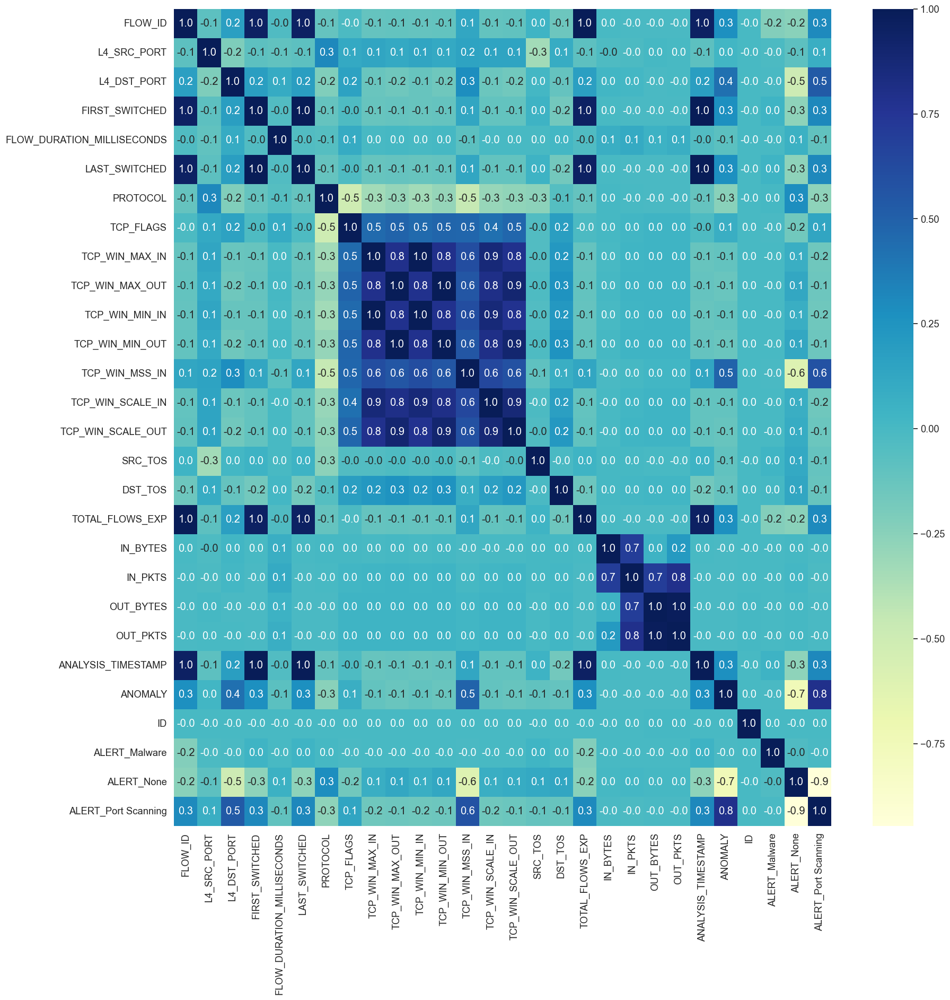

In [701]:
alert_values = pd.get_dummies(train_df_new['ALERT'], prefix='ALERT', drop_first=True)

corr_df = pd.concat([train_df_new.drop('ALERT', axis=1), alert_values], axis=1)

correlation_plot = corr_df.corr(numeric_only=True)
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_plot, annot=True, fmt=".1f", cmap="YlGnBu")

As we can see <b>`IN_BYTES` - `OUT_BYTES`</b> and <b>`IN_PKTS` - `OUT_PKTS`</b> are <b>highly correlated</b> with eachother. <br> <br>

Also, we can observe that a port scanning alert is highly correlated with the <b>`L4_DST_PORT`</b> and <b>`ANOMALY`</b> features. As there are different kind of malwares so its not easy to find correlation with different features. <br><br>

On the contrary, <b>none<b> alerts are strongly negatively correlated with <b>`ANOMALY`</b> and <b>`L4_DST_PORT`</b>

#### 3.6) Analysis of other features using Histogram

In [702]:
# Create a histogram for PROTOCOL_MAP with ANOMALY as the color
hist_plot = px.histogram(train_df_new, 
                   x='PROTOCOL_MAP', 
                   color='ANOMALY', 
                   barmode='group',
                   title='Distribution of Protocols based on the presence/absence of Anomaly', log_y = True)

                

# Update x-axis labels for better readability
hist_plot.update_layout(xaxis_title='Protocol Type', yaxis_title='Count')
hist_plot.update_xaxes(tickangle=45)  # Rotate the x-axis labels for better readability

# Show the plot
hist_plot.show()

The above figure suggests the trend of presence and absence of anamolies as per the different Protocol types. And we can observe that TCP has the most number of Anamoly count in both types.

In [703]:
hist_plot_2 = px.histogram(train_df_new, 
                   x='PROTOCOL_MAP', 
                   color='ALERT', 
                   barmode='group',
                   title='Distribution of Protocols for Each Type of Alert', log_y = True)

# Update x-axis labels for better readability
hist_plot_2.update_layout(xaxis_title='Protocol Type', yaxis_title='Count')
hist_plot_2.update_xaxes(tickangle=45)  # Rotate the x-axis labels for better readability

# Show the plot
hist_plot_2.show()

In [704]:
hist_plot_3 = px.histogram(
    train_df_new,
    x='FLOW_DURATION_MILLISECONDS',
    nbins=50,  # You can adjust the number of bins
    title='Flow Duration Distribution',
    labels={'FLOW_DURATION_MILLISECONDS': 'Flow Duration (Milliseconds)'},
    color='ALERT',
    log_y=True
)

# Update layout
hist_plot_3.update_layout(
    xaxis_title='Flow Duration (Milliseconds)',
    yaxis_title='Count',
    template='plotly_white'
)

# Show the plot
hist_plot_3.show()


After doing the above analysis we found out that the below columns are also required to be dropped as they does not help in model building
- `FLOW_ID`
- `ID`
- `ANALYSIS_TIMESTAMP`
- `IPV4_SRC_ADDR`
- `IPV4_DST_ADDR`
- `PROTOCOL_MAP`

In [705]:
train_df_new = train_df_new.drop(['FLOW_ID','ID','ANALYSIS_TIMESTAMP', 'IPV4_DST_ADDR', 'PROTOCOL_MAP'],axis = 1)
train_df_new.head()

,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,TCP_FLAGS,TCP_WIN_MAX_IN,TCP_WIN_MAX_OUT,...,TCP_WIN_SCALE_OUT,SRC_TOS,DST_TOS,TOTAL_FLOWS_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANOMALY,ALERT
0,62980,10.114.241.166,47736,1647766047,0,1647766047,6,22,1024,0,...,0,0,0,372246818,44,1,40,1,0.0,Port Scanning
1,44246,10.114.227.143,53,1647761040,0,1647761040,17,0,0,0,...,0,0,0,372024895,73,1,121,1,0.0,None
2,36150,10.114.225.212,5228,1647346083,144,1647346083,6,24,713,265,...,0,0,0,334833539,132,2,130,2,0.0,None
3,33858,10.114.225.206,6443,1647693586,0,1647693586,6,2,64240,0,...,0,0,0,369619889,60,1,0,0,1.0,None
4,48586,10.114.227.52,53,1647752706,0,1647752706,17,0,0,0,...,0,0,0,371759146,91,1,146,1,0.0,None


### 4) Preparing Data for Modeling

#### 4.1) Importing Machine Learning Libraries

In [733]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedShuffleSplit, GridSearchCV, cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import Ridge, Lasso
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import accuracy_score
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
import umap
from sklearn.manifold import TSNE
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout
from tensorflow.keras.datasets import mnist
from tensorflow.keras.optimizers import Adam
from keras_tuner import RandomSearch


#### 4.2) Label Encoding for the target column: <b>`ALERT`</b>

In [707]:
Alert_counts

,Alert,Total Count
0,None,109891
1,Port Scanning,15105
2,Denial of Service,1516
3,Malware,17


In [708]:
label_encoder = LabelEncoder()

train_df_new['ALERT'] = label_encoder.fit_transform(train_df_new['ALERT'])
train_df_new=train_df_new.reset_index(drop=True)
train_df_new

,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,TCP_FLAGS,TCP_WIN_MAX_IN,TCP_WIN_MAX_OUT,...,TCP_WIN_SCALE_OUT,SRC_TOS,DST_TOS,TOTAL_FLOWS_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANOMALY,ALERT
0,62980,10.114.241.166,47736,1647766047,0,1647766047,6,22,1024,0,...,0,0,0,372246818,44,1,40,1,0.0,3
1,44246,10.114.227.143,53,1647761040,0,1647761040,17,0,0,0,...,0,0,0,372024895,73,1,121,1,0.0,2
2,36150,10.114.225.212,5228,1647346083,144,1647346083,6,24,713,265,...,0,0,0,334833539,132,2,130,2,0.0,2
3,33858,10.114.225.206,6443,1647693586,0,1647693586,6,2,64240,0,...,0,0,0,369619889,60,1,0,0,1.0,2
4,48586,10.114.227.52,53,1647752706,0,1647752706,17,0,0,0,...,0,0,0,371759146,91,1,146,1,0.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126524,25977,91.106.16.219,47921,1647416650,0,1647416650,6,22,7300,0,...,0,40,0,338816157,60,1,40,1,0.0,2
126525,28687,10.114.225.204,53,1647694456,2,1647694456,17,0,0,0,...,0,0,0,369656474,112,2,328,2,0.0,2
126526,34451,10.114.226.5,53,1647412438,30,1647412438,17,0,0,0,...,0,0,0,338471395,100,1,156,1,0.0,2
126527,55257,10.114.226.5,53,1647347134,15,1647347134,17,0,0,0,...,0,0,164,334965430,93,1,128,1,0.0,2


In [709]:
Alert_counts_encoded = train_df_new['ALERT'].value_counts().reset_index(name='Count')
Alert_counts_encoded

,ALERT,Count
0,2,109891
1,3,15105
2,0,1516
3,1,17


#### 4.3) Label Encoding the Category Columns

In [710]:
category_column_new = train_df_new.select_dtypes(exclude=['int', 'float'])
category_column_new

,IPV4_SRC_ADDR
0,10.114.241.166
1,10.114.227.143
2,10.114.225.212
3,10.114.225.206
4,10.114.227.52
...,...
126524,91.106.16.219
126525,10.114.225.204
126526,10.114.226.5
126527,10.114.226.5


Label Encoding for the train data

In [711]:
train_df_new['IPV4_SRC_ADDR'] = label_encoder.fit_transform(train_df_new['IPV4_SRC_ADDR'])
train_df_new

,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,TCP_FLAGS,TCP_WIN_MAX_IN,TCP_WIN_MAX_OUT,...,TCP_WIN_SCALE_OUT,SRC_TOS,DST_TOS,TOTAL_FLOWS_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANOMALY,ALERT
0,62980,113,47736,1647766047,0,1647766047,6,22,1024,0,...,0,0,0,372246818,44,1,40,1,0.0,3
1,44246,76,53,1647761040,0,1647761040,17,0,0,0,...,0,0,0,372024895,73,1,121,1,0.0,2
2,36150,59,5228,1647346083,144,1647346083,6,24,713,265,...,0,0,0,334833539,132,2,130,2,0.0,2
3,33858,58,6443,1647693586,0,1647693586,6,2,64240,0,...,0,0,0,369619889,60,1,0,0,1.0,2
4,48586,86,53,1647752706,0,1647752706,17,0,0,0,...,0,0,0,371759146,91,1,146,1,0.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126524,25977,7878,47921,1647416650,0,1647416650,6,22,7300,0,...,0,40,0,338816157,60,1,40,1,0.0,2
126525,28687,56,53,1647694456,2,1647694456,17,0,0,0,...,0,0,0,369656474,112,2,328,2,0.0,2
126526,34451,65,53,1647412438,30,1647412438,17,0,0,0,...,0,0,0,338471395,100,1,156,1,0.0,2
126527,55257,65,53,1647347134,15,1647347134,17,0,0,0,...,0,0,164,334965430,93,1,128,1,0.0,2


Label Encoding for the test data

In [712]:
test_df_new['IPV4_SRC_ADDR'] = label_encoder.fit_transform(test_df_new['IPV4_SRC_ADDR'])
test_df_new

,FLOW_ID,PROTOCOL_MAP,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,IPV4_DST_ADDR,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,...,MAX_IP_PKT_LEN,TOTAL_PKTS_EXP,TOTAL_BYTES_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANALYSIS_TIMESTAMP,ANOMALY,ID
0,372014841,tcp,59390,52,443,172.67.164.146,1647760701,196,1647760701,6,...,0,0,0,1465,13,4283,10,1647760752,0.0,524383
1,334916028,tcp,443,3695,25818,10.114.225.205,1647346641,105172,1647346746,6,...,0,0,0,680,8,320,8,1647346807,0.0,1593641
2,338825265,tcp,50422,52,443,96.47.72.106,1647416761,11076,1647416772,6,...,0,0,0,3199,13,18749,20,1647433134,0.0,577266
3,367390748,tcp,33216,101,9177,10.114.224.151,1647679891,0,1647679891,6,...,0,0,0,44,1,40,1,1647679992,1.0,1643880
4,370257697,icmp,0,57,0,18.130.217.232,1647708363,18204,1647708382,1,...,0,0,0,168,2,0,0,1647708660,1.0,1864803
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62315,334740290,tcp,34954,50,5228,74.125.133.188,1647345338,122,1647345338,6,...,0,0,0,226,3,182,3,1647345417,0.0,1810911
62316,370416102,udp,41386,85,53,10.114.226.5,1647712538,0,1647712538,17,...,0,0,0,76,1,92,1,1647712612,0.0,1977671
62317,338721227,tcp,49856,50,80,84.53.161.185,1647415640,4118,1647415644,6,...,0,0,0,163896,2647,6167334,4119,1647427420,0.0,1927400
62318,335540156,tcp,8080,4780,40122,10.114.224.73,1647352492,0,1647352492,6,...,0,0,0,40,1,0,0,1647352561,0.0,1445294


#### 4.4) Data Scaling and Splitting the Train Data

Since we already have a test set, we split our training set in training and validation sets. We will use Sklearn's <b>`StratifiedShuffleSplit`</b> to split the training set in 80% training and 20% validation maintaining the same distribution of the target variable. This is needed since the dataset is highly imbalanced.

In [713]:
def train_val_split(X, y):
  stratifiedShuffle=StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=9)
  indexes = stratifiedShuffle.split(X, y)
  train_indices, test_indices = next(indexes)
  return X.iloc[train_indices], X.iloc[test_indices], y.iloc[train_indices], y.iloc[test_indices]

In [714]:
X_train, X_val, y_train, y_val = train_val_split(train_df_new.drop('ALERT', axis=1), train_df_new['ALERT'])

Check if Dataset is Balanced or not

In [715]:
print('Train set distribution:')
print(y_train.value_counts(normalize=True))
print()
print('Validation set distribution:')
print(y_val.value_counts(normalize=True))

Train set distribution:
ALERT
2    0.868508
3    0.119380
0    0.011983
1    0.000128
Name: proportion, dtype: float64

Validation set distribution:
ALERT
2    0.868490
3    0.119379
0    0.011973
1    0.000158
Name: proportion, dtype: float64


Scaling using the MinMaxScaler for the train and validation Data

In [716]:
minmax_scaler = MinMaxScaler()

minmax_scaled_X_train_data = minmax_scaler.fit_transform(X_train)
minmax_scaled_X_val_data = minmax_scaler.fit_transform(X_val)

minmax_scaled_X_train_data = pd.DataFrame(minmax_scaled_X_train_data, columns=X_train.columns)
minmax_scaled_X_val_data = pd.DataFrame(minmax_scaled_X_val_data, columns=X_val.columns)

Scaling using StandardScaler for the train and validation data

In [717]:
Std_scaler = StandardScaler()

Std_scaled_X_train_data = Std_scaler.fit_transform(X_train)
Std_scaled_X_val_data = Std_scaler.fit_transform(X_val)

Std_scaled_X_train_data = pd.DataFrame(Std_scaled_X_train_data, columns=X_train.columns)
Std_scaled_X_val_data = pd.DataFrame(Std_scaled_X_val_data, columns=X_val.columns)

Removing the same unecessary columns as of train data from the test data

In [718]:
test_df_new = test_df_new.drop(['FLOW_ID', 'ID', 'ANALYSIS_TIMESTAMP', 'IPV4_DST_ADDR', 'PROTOCOL_MAP', 'MIN_IP_PKT_LEN', 
                                'MAX_IP_PKT_LEN', 'TOTAL_PKTS_EXP', 'TOTAL_BYTES_EXP'], axis=1)
test_df_new = test_df_new.reset_index(drop=True)
test_df_new.head()

,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,TCP_FLAGS,TCP_WIN_MAX_IN,TCP_WIN_MAX_OUT,...,TCP_WIN_SCALE_IN,TCP_WIN_SCALE_OUT,SRC_TOS,DST_TOS,TOTAL_FLOWS_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANOMALY
0,59390,52,443,1647760701,196,1647760701,6,27,64240,65535,...,7,10,0,164,372014841,1465,13,4283,10,0.0
1,443,3695,25818,1647346641,105172,1647346746,6,24,142,252,...,0,0,40,0,334916028,680,8,320,8,0.0
2,50422,52,443,1647416761,11076,1647416772,6,27,64240,65535,...,8,6,0,0,338825265,3199,13,18749,20,0.0
3,33216,101,9177,1647679891,0,1647679891,6,22,1024,0,...,0,0,0,0,367390748,44,1,40,1,1.0
4,0,57,0,1647708363,18204,1647708382,1,0,0,0,...,0,0,0,0,370257697,168,2,0,0,1.0


Scaling test data using StadardScaler

In [719]:
Std_x_test_scaled = StandardScaler().fit_transform(test_df_new)

Std_x_test_scaled = pd.DataFrame(Std_x_test_scaled, columns=test_df_new.columns)

Std_x_test_scaled.head()

,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,TCP_FLAGS,TCP_WIN_MAX_IN,TCP_WIN_MAX_OUT,...,TCP_WIN_SCALE_IN,TCP_WIN_SCALE_OUT,SRC_TOS,DST_TOS,TOTAL_FLOWS_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANOMALY
0,0.902683,-0.400465,-0.471610,1.111831,-0.254318,1.111803,-0.723129,1.077496,2.303960,2.862137,...,2.205417,3.261838,-0.301677,3.254727,0.960116,-0.018891,-0.016363,-0.008342,-0.008494,-0.331190
1,-2.162094,2.603017,1.009140,-1.285244,4.425899,-1.284678,-0.723129,0.881721,-0.457566,-0.383658,...,-0.413837,-0.373360,0.696269,-0.333263,-1.122981,-0.020071,-0.020277,-0.008680,-0.008744,-0.331190
2,0.436418,-0.400465,-0.471610,-0.879306,0.230753,-0.879281,-0.723129,1.077496,2.303960,2.862137,...,2.579597,1.807758,-0.301677,-0.333263,-0.903477,-0.016285,-0.016363,-0.007111,-0.007243,-0.331190
3,-0.458158,-0.360067,0.038060,0.644006,-0.263056,0.643975,-0.723129,0.751204,-0.419567,-0.396187,...,-0.413837,-0.373360,-0.301677,-0.333263,0.700473,-0.021027,-0.025756,-0.008703,-0.009620,3.019418
4,-2.185127,-0.396343,-0.497461,0.808836,0.548545,0.808916,-1.561952,-0.684483,-0.463684,-0.396187,...,-0.413837,-0.373360,-0.301677,-0.333263,0.861452,-0.020840,-0.024974,-0.008707,-0.009745,3.019418


Scaling test data using MinMaxScaler

In [720]:
MinMax_x_test_scaled = MinMaxScaler().fit_transform(test_df_new)

MinMax_x_test_scaled = pd.DataFrame(MinMax_x_test_scaled, columns=test_df_new.columns)

MinMax_x_test_scaled.head()

,L4_SRC_PORT,IPV4_SRC_ADDR,L4_DST_PORT,FIRST_SWITCHED,FLOW_DURATION_MILLISECONDS,LAST_SWITCHED,PROTOCOL,TCP_FLAGS,TCP_WIN_MAX_IN,TCP_WIN_MAX_OUT,...,TCP_WIN_SCALE_IN,TCP_WIN_SCALE_OUT,SRC_TOS,DST_TOS,TOTAL_FLOWS_EXP,IN_BYTES,IN_PKTS,OUT_BYTES,OUT_PKTS,ANOMALY
0,0.906233,0.010044,0.006760,0.484123,0.001633,0.484109,0.087719,0.121076,0.980240,1.000000,...,0.583333,0.714286,0.000000,0.694915,0.993692,1.983528e-05,0.000048,1.550295e-06,5.324887e-06,0.0
1,0.006760,0.713734,0.393957,0.018930,0.876455,0.019020,0.087719,0.107623,0.002167,0.003845,...,0.000000,0.000000,0.169492,0.000000,0.894597,8.999723e-06,0.000028,1.158287e-07,4.259910e-06,0.0
2,0.769390,0.010044,0.006760,0.097709,0.092302,0.097696,0.087719,0.121076,0.980240,1.000000,...,0.666667,0.428571,0.000000,0.000000,0.905039,4.377012e-05,0.000048,6.786477e-06,1.064977e-05,0.0
3,0.506844,0.019509,0.140032,0.393334,0.000000,0.393317,0.087719,0.098655,0.015625,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.981341,2.208521e-07,0.000000,1.447859e-08,5.324887e-07,1.0
4,0.000000,0.011010,0.000000,0.425322,0.151704,0.425327,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.988999,1.932456e-06,0.000004,0.000000e+00,0.000000e+00,1.0


### 5) UMAP & t-SNE Visualization

<b>UMAP (Uniform Manifold Approximation and Projection)</b> is a powerful dimensionality reduction technique designed to visualize high-dimensional data, such as the dataset used in this project, We will use <b>UMAP</b> to visualize the training dataset in 2D and this will help us understand if it is possible to separate the different classes of attacks in the dataset or not.<br><br>
<b>t-SNE (t-Distributed Stochastic Neighbor Embedding)</b> is a non-linear dimensionality reduction technique particularly effective for visualizing high-dimensional data and we will apply <b>t-SNE</b> to map the training dataset into a 2D space, helping us explore whether the different attack classes form distinguishable clusters as this will provide insights into the underlying structure of the data and the extent to which the classes overlap or separate.

#### 5.1) UMAP Visualization

Reduce data dimensionality to 2 dimensions and plot the standard scaled data using matplotlib, sns and UMAP.

In [839]:
umap_reducer = umap.UMAP(random_state=42, n_neighbors=50, min_dist=0.3)

Std_umap_mapper = umap_reducer.fit(Std_scaled_X_train_data)

/Users/shivansh052k/Library/Python/3.9/lib/python/site-packages/umap/umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



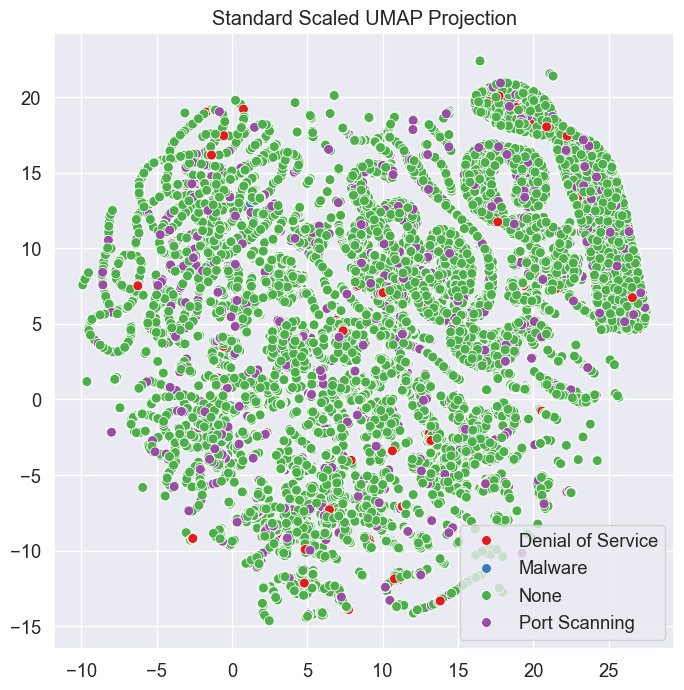

In [840]:
Std_embedding = Std_umap_mapper.transform(Std_scaled_X_train_data)

Std_umap_df = pd.DataFrame(Std_embedding)
Std_umap_df['Target'] = y_train

unique_classes = y_train.unique()
palette = sns.color_palette("Set1", n_colors=len(unique_classes))

legend_labels = {0.0: 'Denial of Service', 1.0: 'Malware', 2.0: 'None', 3.0: 'Port Scanning'}


plt.figure(figsize=(8, 8))
st_umap = sns.scatterplot(Std_umap_df,
                          x=Std_embedding[:, 0], 
                          y=Std_embedding[:, 1],
                          hue='Target',
                          palette=palette, 
                          s=50,
)

handles, labels = st_umap.get_legend_handles_labels()
new_labels = [legend_labels[float(label)] for label in labels]
plt.legend(handles, new_labels)

plt.title("Standard Scaled UMAP Projection")
plt.gca().set_aspect('equal', 'datalim')
plt.show()


Plotting the standard scaled data using `umap.plot` (which uses matplotlib under the hood)

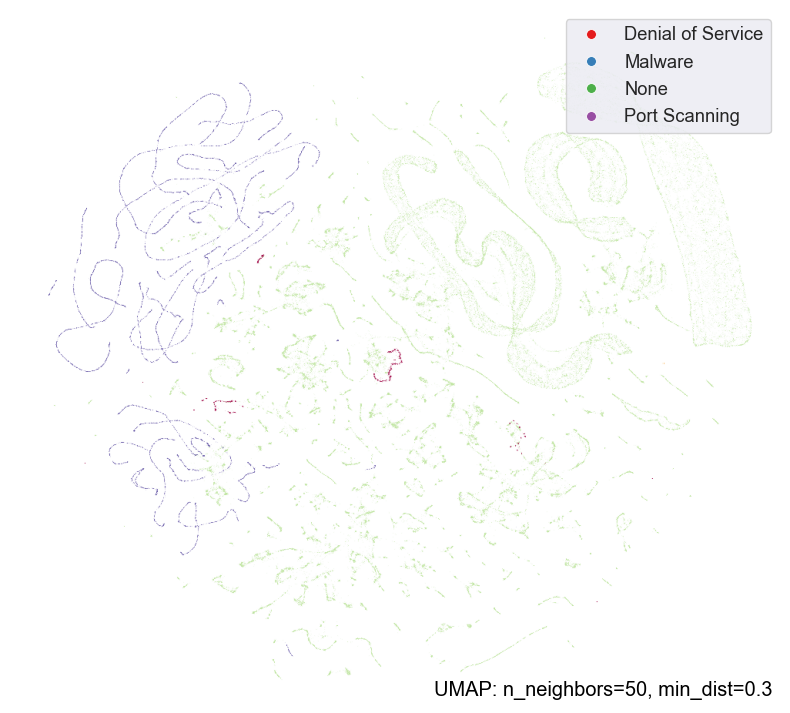

In [841]:
import umap.plot

p = umap.plot.points(
    Std_umap_mapper,
    width=1000,
    labels=y_train,
    height=900
)

legend_labels = {0.0: 'Denial of Service', 1.0: 'Malware', 2.0: 'None', 3.0: 'Port Scanning'}

handles, labels = st_umap.get_legend_handles_labels()
new_labels = [legend_labels[float(label)] for label in labels]
plt.legend(handles, new_labels)

umap.plot.show(p)

#### 5.2) t-SNE Visualization

Reduce data dimensionality to 2 dimensions and plot the standard scaled data using matplotlib, sns and t-SNE.

In [842]:
tsne = TSNE(n_components=2, 
            random_state=42, 
            perplexity=50, 
            learning_rate=500)

std_tsne = tsne.fit_transform(Std_scaled_X_train_data)

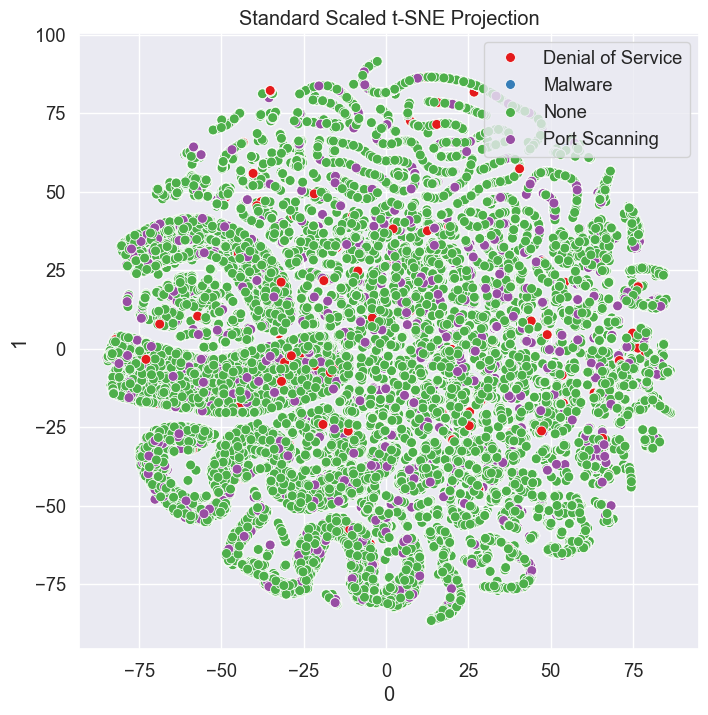

In [844]:
std_tsne_df = pd.DataFrame(std_tsne, columns=['0', '1'])
std_tsne_df['Target'] = y_train

plt.figure(figsize=(8, 8))
st_tsne = sns.scatterplot(data=std_tsne_df,
                          x='0', 
                          y='1',
                          hue='Target',
                          palette=palette, 
                          s=50,
)

handles, labels = st_umap.get_legend_handles_labels()
new_labels = [legend_labels[float(label)] for label in labels]
plt.legend(handles, new_labels)

plt.title("Standard Scaled t-SNE Projection")
# plt.gca().set_aspect('equal', 'datalim')
plt.show()



From the above UMAP and t-SNE grpah we found out: 
<ul>
<li><b>Clusters and Categories:</b> The data points are color-coded into four categories: ‘Denial of Service’ (red), ‘Malware’ (green), ‘None’ (purple), and ‘Port Scanning’ (orange). Each category forms clusters, indicating that similar data points are grouped together.</li><br>
<li><b>Overlap and Separation:</b> While there is some overlap between the categories, distinct regions where certain categories dominate can be observed. For example, the clusters for Denial of Service and Malware appear to be somewhat separated from the other clusters, indicating that these attack types might have distinct features. On the other hand, There is some overlap between the clusters, suggesting that certain attacks may share similarities or be difficult to differentiate based solely on network traffic features.</li><br>
<li><b>Patterns and Anomalies:</b> The UMAP helps identify patterns within the data. For instance, if ‘Malware’ points are clustered tightly together, it suggests a strong similarity among those data points. Conversely, if there are outliers or scattered points, it might indicate anomalies or unique cases within that category.</li>
</ul>

### 6) Model Training and Testing

we will train our scaled dataset on different classification and regression models and compare their results. We will use the following six models:
<ul><b>
<li>K-Nearest Neighbors (KNN)</li> 
<li>Linear Regression</li>
<li>Logistic Regression</li>
<li>Random Forest Classifier</li>
<li>Support Vector Machine (SVM) Classifier with RBF kernel (Radial Basis Function)</li>
<li>Bagging Classifier (SVM Classifier with RBF kernel)</li>
<li>Autoencoder
</b></ul>

#### 6.1) K-Nearest Neighbors (KNN)

##### 6.1.1) Finding the best K hyperparameter for our KNN model

We will use the <b>GridSearchV</b> on the `validation set` to find the best `K` for our model. We will then use this `K value` to train the model on the training set and evaluate it on the test set.

In [845]:
knn = KNeighborsClassifier()
KNN_range = list(range(1, 31))
param_grid = dict(n_neighbors=KNN_range)

grid_search = GridSearchCV(knn, param_grid, cv=3, scoring='accuracy', n_jobs=-1)

grid_search.fit(Std_scaled_X_train_data, y_train)

print(f"Best k: {grid_search.best_params_['n_neighbors']}")
print(f"Best Accuracy: {grid_search.best_score_ * 100:.2f}%")


Best k: 1
Best Accuracy: 99.94%


Plotting the optimal K on different accuracies

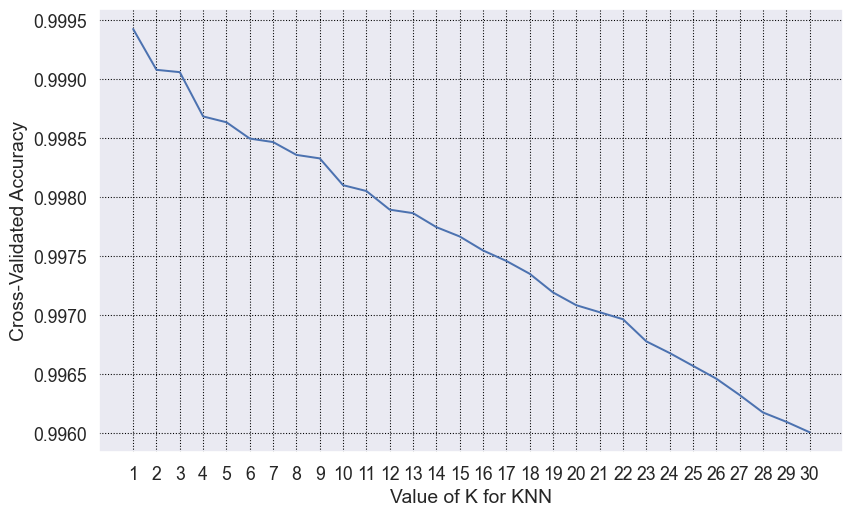

In [846]:
plt.figure(num=0, dpi=96, figsize=(10, 6))
plt.plot(KNN_range, grid_search.cv_results_['mean_test_score'])
plt.grid(which='major', linestyle=':', linewidth=0.8, color='black')
plt.xlabel('Value of K for KNN')
plt.ylabel('Cross-Validated Accuracy')
plt.xticks(KNN_range)
plt.show()

As per the above graph <b>`K = 1`</b> is the most optimal K hyperparameter, but this value lead our model to <b>overfitting</b>, so we will use the first odd number after 1, which is <b>`K = 3`</b>.

##### 6.1.2) Model Fitting and validation

On analysis we found that we are getting better accuracy for the KNN model with `Standard Scaled` Data, so we moved ahead with it

In [847]:
KNN_std_scaled = KNeighborsClassifier(n_neighbors=3)

KNN_std_scaled.fit(Std_scaled_X_train_data, y_train)

std_scaled_pred = KNN_std_scaled.predict(Std_scaled_X_val_data)

KNN_Accuracy = round(accuracy_score(y_val, std_scaled_pred) * 100, 2)

print(f"Validation Accuracy on the Stadard Scaled Data: {KNN_Accuracy}%")
print("\n------------------Classification Report------------------\n")
print(classification_report(y_val, std_scaled_pred))

Validation Accuracy on the Stadard Scaled Data: 99.91%

------------------Classification Report------------------

              precision    recall  f1-score   support

           0       0.94      1.00      0.97       303
           1       1.00      1.00      1.00         4
           2       1.00      1.00      1.00     21978
           3       1.00      1.00      1.00      3021

    accuracy                           1.00     25306
   macro avg       0.99      1.00      0.99     25306
weighted avg       1.00      1.00      1.00     25306



As a result, <b>`99.91%`</b> accuracy was achieved with the <b>K-Nearest Neighbor Model</b> for the `Standard Scaled Data`

Plotting the above Confusion Matrix

<Axes: >

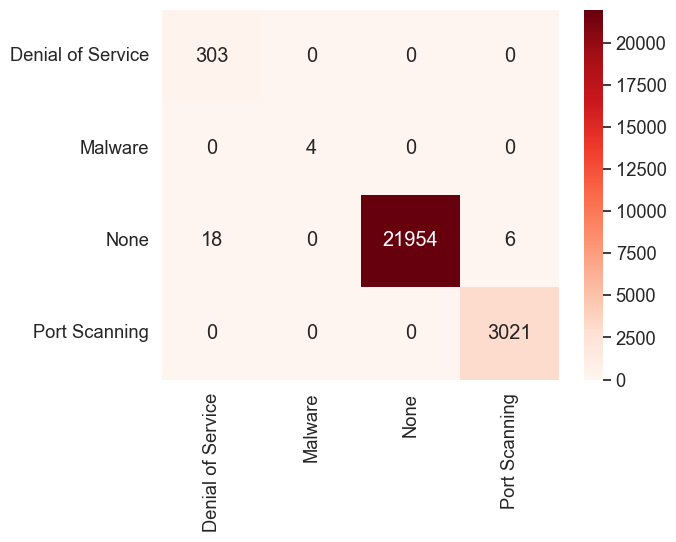

In [848]:
knn_cmat = confusion_matrix(y_val, std_scaled_pred)
knn_cmat = pd.DataFrame(knn_cmat, index=['Denial of Service', 'Malware', 'None', 'Port Scanning'], columns=['Denial of Service', 'Malware', 'None', 'Port Scanning'])

# Using seaborn to visualize the confusion matrix
sns.set(font_scale=1.2) # for label size
sns.heatmap(knn_cmat, annot=True, fmt='d', cmap='Reds')

##### 6.1.3) KNN predictions on the test set

As we don't have the target variable in the test data, so we can't evaluate our model, inplace we can make predictions using that data

In [849]:
KNN_test_predictions = KNN_std_scaled.predict(Std_x_test_scaled)
pd.Series(KNN_test_predictions).value_counts() # Print the predictions size per class

2    54038
3     7516
0      761
1        5
Name: count, dtype: int64

Plotting the predictions using KNN model

In [850]:
KNN_predictions_series = pd.Series(KNN_test_predictions).value_counts().reset_index()
KNN_predictions_series.columns = ['Class', 'Count']  # Rename columns

class_labels = {0.0: 'Denial of Service', 1.0: 'Malware', 2.0: 'None', 3.0: 'Port Scanning'}
KNN_predictions_series['Class'] = KNN_predictions_series['Class'].map(class_labels)


KNN_bar = px.bar(
    KNN_predictions_series, 
    x='Class', 
    y='Count',
    color='Class', 
    log_y=True,
    title='Predictions Distribution on the Test Set (KNN Model)',
)

KNN_bar.update_layout(
    xaxis_title='Predicted Class',
    yaxis_title='Count',
)

KNN_bar.show()

#### 6.2) Linear Regression

##### 6.2.1) Finding the best hyperparameters for our Linear Regression (Ridge & Lasso Regression)

We will find the most optimal hyperparameters using the `GridSearchCV` for the Ridge Regression

In [851]:
ridge_parameters = {'alpha': [0.1, 1.0, 10.0, 100.0], 'solver': ['auto', 'svd', 'cholesky']}

ridge = Ridge()
ridge_grid = GridSearchCV(ridge, ridge_parameters, cv=5, scoring='r2')
ridge_grid.fit(Std_scaled_X_train_data, y_train)

print(f'Best Parameters for the Ridge Regression: {ridge_grid.best_params_}')
best_ridge = ridge_grid.best_estimator_

Best Parameters for the Ridge Regression: {'alpha': 1.0, 'solver': 'svd'}


We will find the most optimal hyperparameters using the `GridSearchCV` for the Lasso Regression

In [852]:
lasso_params = {'alpha': [0.001, 0.01, 0.1, 1.0], 'max_iter': [1000, 5000, 10000]}

lasso = Lasso()
lasso_grid = GridSearchCV(lasso, lasso_params, cv=5, scoring='r2')
lasso_grid.fit(Std_scaled_X_train_data, y_train)

print(f'Best Parameters: {lasso_grid.best_params_}')
best_lasso = lasso_grid.best_estimator_

Best Parameters: {'alpha': 0.001, 'max_iter': 1000}


##### 6.2.2) Model Fitting and validation

Using Ridge Regression

In [853]:
Ridge_pred = best_ridge.predict(Std_scaled_X_val_data)

Ridge_MSE = mean_squared_error(y_val, Ridge_pred)
Ridge_R2 = round(r2_score(y_val, Ridge_pred)*100,2)


print(f"Validation Accuracy (R² Score) on Standard Scaled Data: {Ridge_R2}%")
print(f"Mean Squared Error for the Validation Set: {Ridge_MSE}")

Validation Accuracy (R² Score) on Standard Scaled Data: 66.47%
Mean Squared Error for the Validation Set: 0.053092669546348496


Using Lasso Regression

In [854]:
Lasso_pred = best_lasso.predict(Std_scaled_X_val_data)

Lasso_MSE = mean_squared_error(y_val, Lasso_pred)
Lasso_R2 = round(r2_score(y_val, Lasso_pred)*100,2)

print(f"Validation Accuracy (R² Score) on Standard Scaled Data: {Lasso_R2}%")
print(f"Mean Squared Error for the Validation Set: {Lasso_MSE}")

Validation Accuracy (R² Score) on Standard Scaled Data: 66.61%
Mean Squared Error for the Validation Set: 0.052878120492646154


As a result, <b>`66.47%`</b> & <b>`66.61`</b> accuracy was achieved with the <b>Ridge Regression</b> & <b>Lasso Regression</b> respectively, for the `Standard Scaled Data`

#### 6.3) Logistic Regression

##### 6.3.1) Model Fitting and Validation

On analysis we found that we are getting better accuracy for the Logistic Regression model with `Standard Scaled` Data, so we moved ahead with it

In [855]:
Logistic_model = LogisticRegression(max_iter=200, penalty='l2')
Logistic_model.fit(Std_scaled_X_train_data, y_train)

Logistic_pred = Logistic_model.predict(Std_scaled_X_val_data)

Logistic_accuracy = round(accuracy_score(y_val, Logistic_pred)*100,2)

print(f"Validation Accuracy on the Stadard Scaled Data: {Logistic_accuracy}%")
print("\n------------------Classification Report------------------\n")
print(classification_report(y_val, Logistic_pred))

Validation Accuracy on the Stadard Scaled Data: 99.4%

------------------Classification Report------------------

              precision    recall  f1-score   support

           0       0.71      0.86      0.78       303
           1       1.00      1.00      1.00         4
           2       1.00      1.00      1.00     21978
           3       1.00      1.00      1.00      3021

    accuracy                           0.99     25306
   macro avg       0.93      0.96      0.94     25306
weighted avg       0.99      0.99      0.99     25306



As a result, <b>`99.4%`</b> accuracy was achieved with the <b>Logistic Regression Model</b> for the `Standard Scaled Data`

<Axes: >

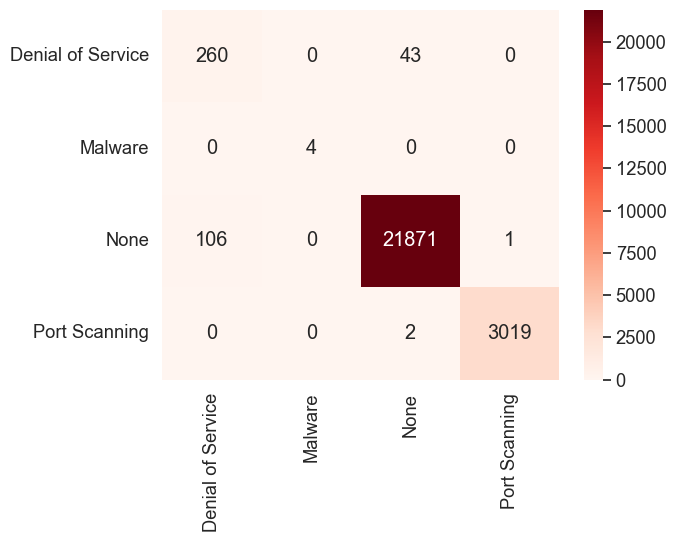

In [856]:
LogisticReg_cmat = confusion_matrix(y_val, Logistic_pred)
LogisticReg_cmat = pd.DataFrame(LogisticReg_cmat, index=['Denial of Service', 'Malware', 'None', 'Port Scanning'], columns=['Denial of Service', 'Malware', 'None', 'Port Scanning'])

# Using seaborn to visualize the confusion matrix
sns.set(font_scale=1.2) # for label size
sns.heatmap(LogisticReg_cmat, annot=True, fmt='d', cmap='Reds')

##### 6.3.2) Logistic Regression prediction on the test set

In [857]:
Logistic_test_predictions = Logistic_model.predict(Std_x_test_scaled)
pd.Series(Logistic_test_predictions).value_counts() # Print the predictions size per class

2    54051
3     7503
0      762
1        4
Name: count, dtype: int64

In [858]:
Logistic_predictions_series = pd.Series(Logistic_test_predictions).value_counts().reset_index()
Logistic_predictions_series.columns = ['Class', 'Count']  # Rename columns

class_labels = {0.0: 'Denial of Service', 1.0: 'Malware', 2.0: 'None', 3.0: 'Port Scanning'}
Logistic_predictions_series['Class'] = Logistic_predictions_series['Class'].map(class_labels)


Logistic_bar = px.bar(
    Logistic_predictions_series, 
    x='Class', 
    y='Count',
    color='Class', 
    log_y=True,
    title='Predictions Distribution on the Test Set (Logistic Regression)',
)

Logistic_bar.update_layout(
    xaxis_title='Predicted Class',
    yaxis_title='Count',
)

Logistic_bar.show()

#### 6.4) Random Forest Classifier

##### 6.4.1) Finding the best hyperparameters for our Random Forest Classifier

We will find the most optimal hyperparameters using the `GridSearchCV` for the Ridge Regression

In [859]:
RFC_Model = RandomForestClassifier()

RFC_parameters = {'n_estimators': [1, 2, 4, 10, 15, 20, 30, 40, 50, 100, 200, 500, 1000]}

RFC_grid_search = GridSearchCV(
  RFC_Model,
  RFC_parameters,
  scoring='accuracy',
  cv=2,
  n_jobs=-1
)

RFC_grid_search.fit(Std_scaled_X_train_data, y_train)

print(f"Best params: {RFC_grid_search.best_params_}")
print(f"Best score: {RFC_grid_search.best_score_}")

Best params: {'n_estimators': 20}
Best score: 0.9999407245436581


##### 6.4.2) Model Fitting and Validation

On analysis we found that we are getting better accuracy for the Logistic Regression model with `MinMax Scaler` Data, so we moved ahead with it

In [860]:
RFC_Model = RandomForestClassifier(n_estimators=40)

RFC_Model.fit(minmax_scaled_X_train_data, y_train)

RFC_pred = RFC_Model.predict(minmax_scaled_X_val_data)

RFC_accuracy = round(accuracy_score(y_val, RFC_pred) * 100, 2)

print(f"Validation Accuracy on the Stadard Scaled Data: {RFC_accuracy}%")
print("\n------------------Classification Report------------------\n")
print(classification_report(y_val, RFC_pred))

Validation Accuracy on the Stadard Scaled Data: 100.0%

------------------Classification Report------------------

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       303
           1       1.00      0.75      0.86         4
           2       1.00      1.00      1.00     21978
           3       1.00      1.00      1.00      3021

    accuracy                           1.00     25306
   macro avg       1.00      0.94      0.96     25306
weighted avg       1.00      1.00      1.00     25306



As a result, <b>`100.0%`</b> accuracy was achieved with the <b>Random Forest Classifier</b> for the `MinMax Scaled Data`

<Axes: >

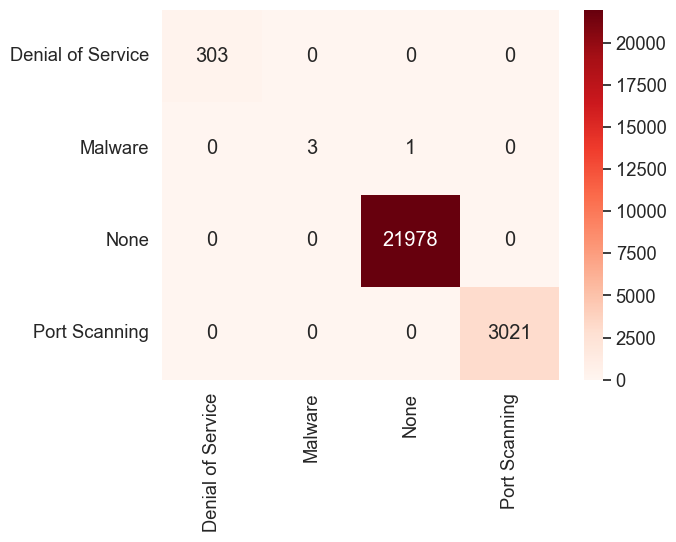

In [861]:
RFC_cmat = confusion_matrix(y_val, RFC_pred)
RFC_cmat = pd.DataFrame(RFC_cmat, index=['Denial of Service', 'Malware', 'None', 'Port Scanning'], columns=['Denial of Service', 'Malware', 'None', 'Port Scanning'])

# Using seaborn to visualize the confusion matrix
sns.set(font_scale=1.2) # for label size
sns.heatmap(RFC_cmat, annot=True, fmt='d', cmap='Reds')

##### 6.4.3) Random Forest Classifier Prediction on the test set

In [862]:
RFC_test_predictions = RFC_Model.predict(MinMax_x_test_scaled)
pd.Series(RFC_test_predictions).value_counts() 

2    54282
3     7424
0      610
1        4
Name: count, dtype: int64

In [863]:
RFC_predictions_series = pd.Series(RFC_test_predictions).value_counts().reset_index()
RFC_predictions_series.columns = ['Class', 'Count']  # Rename columns

class_labels = {0.0: 'Denial of Service', 1.0: 'Malware', 2.0: 'None', 3.0: 'Port Scanning'}
RFC_predictions_series['Class'] = RFC_predictions_series['Class'].map(class_labels)


RFC_bar = px.bar(
    RFC_predictions_series, 
    x='Class', 
    y='Count',
    color='Class', 
    log_y=True,
    title='Predictions Distribution on the Test Set (Random Forest Classifier)',
)

RFC_bar.update_layout(
    xaxis_title='Predicted Class',
    yaxis_title='Count',
)

RFC_bar.show()

#### 6.5) Support Vector Machine (SVM) with RBF kernel (Radial Basis Function)

##### 6.5.1.1) Finding the best hyperparameters for our Simple SVM Classifier

We will find the most optimal hyperparameters for the SVM classifier using `GridSearchCV`

In [864]:
SVM_model = SVC(kernel='rbf')

SVM_param = {'C': [0.1, 1, 10, 100, 1000],
    'gamma': [1, 0.1, 0.01, 0.001, 0.0001]
}

SVM_param_grid = GridSearchCV(
  SVM_model,
  SVM_param,
  cv=2,
  n_jobs=-1
)


SVM_param_grid.fit(Std_scaled_X_train_data, y_train)

print(f"Best params: {SVM_param_grid.best_params_}")
print(f"Best score: {SVM_param_grid.best_score_}")


Best params: {'C': 1000, 'gamma': 1}
Best score: 0.9996838663149371


##### 6.5.1.2) Model Fitting and Validation

On analysis we found that we are getting better accuracy for the Logistic Regression model with `Standard Scaler` Data, so we moved ahead with it

In [865]:
SVM_Model = SVC(kernel='rbf', 
                C=SVM_param_grid.best_params_['C'], 
                gamma=SVM_param_grid.best_params_['gamma'])

SVM_Model.fit(Std_scaled_X_train_data,y_train)

SVM_pred = SVM_Model.predict(Std_scaled_X_val_data)

SVM_accuracy = round(accuracy_score(y_val, SVM_pred) * 100, 2)

print(f"Validation Accuracy on the Stadard Scaled Data: {SVM_accuracy}%")
print("\n------------------Classification Report------------------\n")
print(classification_report(y_val, SVM_pred))

Validation Accuracy on the Stadard Scaled Data: 99.96%

------------------Classification Report------------------

              precision    recall  f1-score   support

           0       0.99      1.00      0.99       303
           1       1.00      0.75      0.86         4
           2       1.00      1.00      1.00     21978
           3       1.00      1.00      1.00      3021

    accuracy                           1.00     25306
   macro avg       1.00      0.94      0.96     25306
weighted avg       1.00      1.00      1.00     25306



As a result, <b>`99.96%`</b> accuracy was achieved with the <b>SVM (RBF Kernerl) Model</b> for the `Standard Scaled Data`

<Axes: >

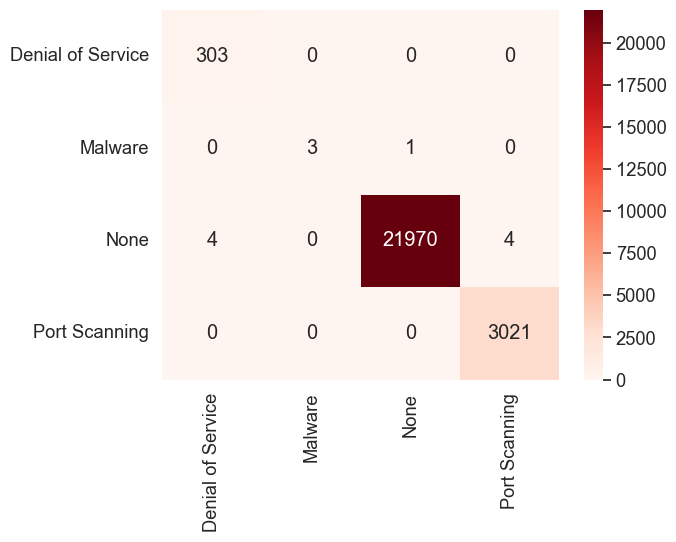

In [866]:
SVM_cmat = confusion_matrix(y_val, SVM_pred)
SVM_cmat = pd.DataFrame(SVM_cmat, index=['Denial of Service', 'Malware', 'None', 'Port Scanning'], columns=['Denial of Service', 'Malware', 'None', 'Port Scanning'])

# Using seaborn to visualize the confusion matrix
sns.set(font_scale=1.2) # for label size
sns.heatmap(SVM_cmat, annot=True, fmt='d', cmap='Reds')

##### 6.5.1.3) Simple SVM Classifier prediction on the test set

In [867]:
SVM_pred_test = SVM_Model.predict(Std_x_test_scaled)
pd.Series(SVM_pred_test).value_counts() 

2    54064
3     7509
0      743
1        4
Name: count, dtype: int64

In [868]:
SVM_predictions_series = pd.Series(SVM_pred_test).value_counts().reset_index()
SVM_predictions_series.columns = ['Class', 'Count']  # Rename columns

class_labels = {0.0: 'Denial of Service', 1.0: 'Malware', 2.0: 'None', 3.0: 'Port Scanning'}
SVM_predictions_series['Class'] = SVM_predictions_series['Class'].map(class_labels)


SVM_bar = px.bar(
    SVM_predictions_series, 
    x='Class', 
    y='Count',
    color='Class', 
    log_y=True,
    title='Predictions Distribution on the Test Set (SVM Classifier using RBF Kernel)',
)

SVM_bar.update_layout(
    xaxis_title='Predicted Class',
    yaxis_title='Count',
)

SVM_bar.show()

#### 6.6) Bagging Classifier

##### 6.6.1) Model Fitting and Validation

In [869]:
SVM_Model_BC = SVC(kernel='rbf',
                   class_weight='balanced',
                   C=SVM_param_grid.best_params_['C'],
                   gamma=SVM_param_grid.best_params_['gamma'])

Bag_Clf = BaggingClassifier(SVM_Model_BC,
                            n_estimators=30,
                            n_jobs=-1,
                            random_state=42)

Bag_Clf.fit(Std_scaled_X_train_data, y_train)

BaggingClassifier(estimator=SVC(C=1000, class_weight='balanced', gamma=1),
                  n_estimators=30, n_jobs=-1, random_state=42)

In [870]:
Bag_Clf_pred = Bag_Clf.predict(Std_scaled_X_val_data)

Bag_accuracy = round(accuracy_score(y_val, Bag_Clf_pred) * 100, 2)

print(f"Validation Accuracy on the Stadard Scaled Data: {Bag_accuracy}%")
print("\n------------------Classification Report------------------\n")
print(classification_report(y_val, Bag_Clf_pred))

Validation Accuracy on the Stadard Scaled Data: 99.96%

------------------Classification Report------------------

              precision    recall  f1-score   support

           0       0.98      1.00      0.99       303
           1       1.00      0.75      0.86         4
           2       1.00      1.00      1.00     21978
           3       1.00      1.00      1.00      3021

    accuracy                           1.00     25306
   macro avg       1.00      0.94      0.96     25306
weighted avg       1.00      1.00      1.00     25306



As a result, <b>`99.96%`</b> accuracy was achieved with the <b>Bagging Classifier Model</b> for the `Standard Scaled Data`

##### 6.6.2) Bagging Classifier Prediciton on the test data

In [871]:
Bag_Clf_pred_test = Bag_Clf.predict(Std_x_test_scaled)
pd.Series(Bag_Clf_pred_test).value_counts() 

2    54063
3     7509
0      744
1        4
Name: count, dtype: int64

In [872]:
Bag_predictions_series = pd.Series(Bag_Clf_pred_test).value_counts().reset_index()
Bag_predictions_series.columns = ['Class', 'Count']  # Rename columns

class_labels = {0.0: 'Denial of Service', 1.0: 'Malware', 2.0: 'None', 3.0: 'Port Scanning'}
Bag_predictions_series['Class'] = Bag_predictions_series['Class'].map(class_labels)


Bag_bar = px.bar(
    Bag_predictions_series, 
    x='Class', 
    y='Count',
    color='Class', 
    log_y=True,
    title='Predictions Distribution on the Test Set (Bagging Classifier)',
)

Bag_bar.update_layout(
    xaxis_title='Predicted Class',
    yaxis_title='Count',
)

Bag_bar.show()

#### 6.7) Autoencoders

##### 6.7.1) Fitting and validating the model

In [873]:
input_dim = Std_scaled_X_train_data.shape[1]

# Encoder
input_layer = Input(shape=(input_dim,))
encoded = Dense(128, activation='relu')(input_layer)
encoded = Dropout(0.2)(encoded)
encoded = Dense(64, activation='relu')(encoded)
latent = Dense(32, activation='relu')(encoded)

# Decoder
decoded = Dense(64, activation='relu')(latent)
decoded = Dense(128, activation='relu')(decoded)
output_layer = Dense(input_dim, activation='sigmoid')(decoded)

# Build and compile the autoencoder
autoencoder = Model(inputs=input_layer, outputs=output_layer)
autoencoder.compile(optimizer=Adam(learning_rate=0.001), 
                    loss='mse',
                    metrics=['mae'])

# Train the autoencoder
auto_history_train = autoencoder.fit(
    Std_scaled_X_train_data, Std_scaled_X_train_data,
    epochs=100,
    batch_size=128,
    shuffle=True,
    validation_data=(Std_scaled_X_val_data, Std_scaled_X_val_data),
    verbose=1,
)

Epoch 1/100
791/791 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - loss: 0.7572 - mae: 0.5307 - val_loss: 0.6051 - val_mae: 0.4425
Epoch 2/100
791/791 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.5522 - mae: 0.4427 - val_loss: 0.6036 - val_mae: 0.4423
Epoch 3/100
791/791 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.5954 - mae: 0.4408 - val_loss: 0.6023 - val_mae: 0.4379
Epoch 4/100
791/791 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.5562 - mae: 0.4380 - val_loss: 0.6013 - val_mae: 0.4379
Epoch 5/100
791/791 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.5463 - mae: 0.4375 - val_loss: 0.6011 - val_mae: 0.4367
Epoch 6/100
791/791 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.5608 - mae: 0.4362 - val_loss: 0.6007 - val_mae: 0.4354
Epoch 7/100
791/791 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.6548 - mae: 0.4368 - val_loss: 0.6007 - val_mae: 0.4359
Epoch 8/100
791/791 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - loss: 0.5507 - mae: 0.4354 - val_loss: 0.6010 - val_mae: 0.4354
Epoch 9/100
791/791 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/

In [874]:
auto_reconstructed_data = autoencoder.predict(Std_scaled_X_val_data)

# Calculate MSE for each sample
mse_per_sample = np.mean(np.square(Std_scaled_X_val_data - auto_reconstructed_data), axis=1)

# Average MSE
auto_average_mse = np.mean(mse_per_sample)
print(f"Average MSE: {auto_average_mse}")

# Threshold for Anamoly detection
auto_train_threshold = np.mean(mse_per_sample) + 3 * np.std(mse_per_sample)
print(f"Threshold for the anomaly detection as per the validation set: {auto_train_threshold}")

auto_val_pred = (mse_per_sample > auto_train_threshold).astype(int)  # 1 = Anomaly, 0 = Normal

# Replacing y_true with your actual labels for validation data
auto_y_true = np.zeros(len(Std_scaled_X_val_data))

auto_accuracy = accuracy_score(auto_y_true, auto_val_pred)
print(f"Anomaly Detection Accuracy: {auto_accuracy * 100:.2f}%")

print("\n------------------Classification Report------------------\n")
print(classification_report(auto_y_true, auto_val_pred))

791/791 ━━━━━━━━━━━━━━━━━━━━ 0s 430us/step
Average MSE: 0.5994453562196592
Threshold for the anomaly detection as per the validation set: 31.86274802663772
Anomaly Detection Accuracy: 99.94%

------------------Classification Report------------------

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     25306
         1.0       0.00      0.00      0.00         0

    accuracy                           1.00     25306
   macro avg       0.50      0.50      0.50     25306
weighted avg       1.00      1.00      1.00     25306



/Users/shivansh052k/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/Users/shivansh052k/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/Users/shivansh052k/Library/Python/3.9/lib/python/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



As a result, <b>`99.94%`</b> accuracy was achieved with the <b>Autoencoders Model</b> for the `Standard Scaled Data`

Plotting the comparison between Train loss and Validation loss

In [875]:
auto_loss_line = make_subplots()

auto_loss_line.add_trace(go.Scatter(
    y=auto_history_train.history['loss'], 
    mode='lines', 
    name='Training Loss'
))

auto_loss_line.add_trace(go.Scatter(
    y=auto_history_train.history['val_loss'], 
    mode='lines', 
    name='Validation Loss'
))

auto_loss_line.update_layout(
    title='Autoencoder Training and Validation Loss',
    xaxis_title='Epochs',
    yaxis_title='Loss (MSE)',
    legend=dict(x=0.7, y=0.9),
    width = 700
)

auto_loss_line.show()

##### 6.7.2) Autoencoders predictions on the test dataset

In [876]:
auto_test_pred = autoencoder.predict(Std_x_test_scaled)

auto_mse_test = np.mean(np.power(Std_x_test_scaled - auto_test_pred, 2), axis=1)

auto_threshold_test = np.percentile(auto_mse_test, 95)  # Use 95th percentile as threshold
print(f"Threshold for anomaly detection: {auto_threshold_test}")

auto_anomalies_test = auto_mse_test > auto_threshold_test
print(f"Number of anomalies detected: {np.sum(auto_anomalies_test)}")

1948/1948 ━━━━━━━━━━━━━━━━━━━━ 1s 390us/step
Threshold for anomaly detection: 1.0337046106536891
Number of anomalies detected: 3116


In [877]:
auto_result_test = auto_anomalies_test.astype(int)
auto_result_test = auto_result_test.value_counts().reset_index()
auto_result_test.columns = ['Predicted Anomaly', 'Count']

auto_result_test = pd.DataFrame(auto_result_test)
auto_result_test

,Predicted Anomaly,Count
0,0,59204
1,1,3116


In [878]:
class_labels = {0: 'No Anomaly', 1: 'Anomaly Found'}
auto_result_test['Predicted Anomaly'] = auto_result_test['Predicted Anomaly'].map(class_labels)

auto_bar = px.bar(
    auto_result_test, 
    x='Predicted Anomaly', 
    y='Count',
    color='Predicted Anomaly', 
    log_y=True,
    title='Predictions Distribution on the Test Set (Bagging Classifier)',
)

auto_bar.update_layout(
    yaxis_title='Count',
    width = 700
)

auto_bar.show()

### 7) Compared Visualization of the Model Accuracies

In [879]:
Model_accuracies = {
    'Models': ['KNN', 'Linear Regression', 'Logistic Regression', 'Random Forest Classifier', 'SVM (RBF Kernel)', 
              'Bagging Classifier', 'Autoencoders'],
    'Accuracy': [KNN_Accuracy, Lasso_R2, Logistic_accuracy, RFC_accuracy, SVM_accuracy, Bag_accuracy, round(auto_accuracy*100,2)]
}

Model_accuracies = pd.DataFrame(Model_accuracies)

Model_accuracies

,Models,Accuracy
0,KNN,99.91
1,Linear Regression,66.61
2,Logistic Regression,99.40
3,Random Forest Classifier,100.00
4,SVM (RBF Kernel),99.96
5,Bagging Classifier,99.96
6,Autoencoders,99.94


In [882]:
Model_Comparison = px.bar(Model_accuracies, 
                          x='Models', 
                          y = 'Accuracy',
                          color ='Models', 
                          log_y=True,
                          title='Comparison of multilpe ML Model Accuracies',
                          labels={'Accuracy': 'Accuracy (%)'},
                          text='Accuracy',
                          width=700)

Model_Comparison.show()

### 8) Conclusion

All classification and regression models have demonstrated outstanding performance, with the exception of <b>Linear Regression</b>. Notably, nearly every model has achieved exceptional accuracy, as indicated by <b>`F1-Scores`</b> approaching the ideal value of <b>`1.00`</b>.<br><br>

After careful analysis, I have concluded that this phenomenon arises from the significant similarity between the `validation set` formed by splitting the `training set` due to the unavailability of the `target` variable in the provided `test set` used for model development.<br><br>

The training set was likely constructed from data sourced from a specific network, leading to a considerable overlap in features between the training and validation sets. As a result, the models demonstrated high accuracy in classifying nearly all flows within the validation set. However, their performance may not be as robust when applied to a separate test set derived from a different network.<br><br>

The most highliting part is that almost every model reached 1.00 as an F-1 score, except <b>Linear Regression</b> because the features used in the linear regression model are not adequately capturing the underlying patterns of the data, the model may not be able to differentiate between classes effectively and hence faced <b>`Feature Overlap`</b>.<br><br>

We have also have opted to present the classification outcomes of each model on the provided `test set`, despite the unavailability of performance metrics for evaluation. On Contary, acquiring a `test set` originating from a diverse network would have been advantageous, enabling a more precise assessment of the models' performance.